# Triplet Loss with Faces

In [ ]:
!pip install torch

In [ ]:
!pip install pytorch-ignite

     |████████████████████████████████| 204kB 26.2MB/s 


In [ ]:
!pip install mat73

### Check device

In [ ]:
!nvidia-smi

Tue May 25 15:54:13 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Import Librairies

In [ ]:
import numpy as np
import random
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from time import perf_counter
from typing import Callable
import itertools
import mat73
import pandas as pd
import re

import sys
import os
import tarfile

from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split

import torch
from torch import nn, optim
import torch.nn.functional as F

from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms

import os.path as op
try:
    from urllib.request import urlretrieve
except ImportError:  # Python 2 compat
    from urllib import urlretrieve

from triplet import TripletGenerator, TripletLearner, TripletLoss
from builder import create_dataframe, build_positive_pairs, build_negative_pairs
from prints import print_img_from_path, print_img_from_id, print_img_from_classid, print_img_category, print_pairs, print_hist
from test_train_loops import training, testing

### Generate Data

In [ ]:
URL = "http://vis-www.cs.umass.edu/lfw/lfw-deepfunneled.tgz"
FILENAME = "lfw-deepfunneled.tgz"

if not op.exists(FILENAME):
    print('Downloading %s to %s...' % (URL, FILENAME))
    urlretrieve(URL, FILENAME)

if not op.exists("lfw"):
    print('Extracting image files...')
    tar = tarfile.open("lfw-deepfunneled.tgz")
    tar.extractall("lfw")
    tar.close()

Extracting image files...


In [ ]:
PATH = "lfw/lfw-deepfunneled/"

In [ ]:
tic = perf_counter()
df = create_dataframe()
toc = perf_counter()
print(f"DataFrame creation: {((toc - tic)/60):.1f} min")

images weigh  1.14 GB
number of classes: 5721
DataFrame creation: 3.1 min


In [ ]:
df.head(3)

,Id,Classid,Name,Img,Path,Male,Asian,White,Black,Baby,Child,Youth,Middle Aged,Senior,Black Hair,Blond Hair,Brown Hair,Bald,No Eyewear,Eyeglasses,Sunglasses,Mustache,Smiling,Frowning,Chubby,Blurry,Harsh Lighting,Flash,Soft Lighting,Outdoor,Curly Hair,Wavy Hair,Straight Hair,Receding Hairline,Bangs,Sideburns,Fully Visible Forehead,Partially Visible Forehead,Obstructed Forehead,Bushy Eyebrows,Arched Eyebrows,Narrow Eyes,Eyes Open,Big Nose,Pointy Nose,Big Lips,Mouth Closed,Mouth Slightly Open,Mouth Wide Open,Teeth Not Visible,No Beard,Goatee,Round Jaw,Double Chin,Wearing Hat,Oval Face,Square Face,Round Face,Color Photo,Posed Photo,Attractive Man,Attractive Woman,Indian,Gray Hair,Bags Under Eyes,Heavy Makeup,Rosy Cheeks,Shiny Skin,Pale Skin,5 o Clock Shadow,Strong Nose-Mouth Lines,Wearing Lipstick,Flushed Face,High Cheekbones,Brown Eyes,Wearing Earrings,Wearing Necktie,Wearing Necklace
0,2,2,Aaron_Eckhart,"[[[-127.85774134082934, -101.65847531187814, -...",Aaron_Eckhart/Aaron_Eckhart_0001.jpg,1,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,1,1,1,0,0,0,0,0,1,0,0,0,0,1,1,1,1,0,1,0,0,1,1,0,1,0,0,1,0,0,1,1,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,0
1,3,3,Aaron_Guiel,"[[[-101.04524134082911, -75.40847531187802, -5...",Aaron_Guiel/Aaron_Guiel_0001.jpg,1,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,1,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,1,1,1,1,1,0,1,0,0,1,0,1,1,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0
2,4,4,Aaron_Patterson,"[[[-27.357741340829307, -21.908475311878107, -...",Aaron_Patterson/Aaron_Patterson_0001.jpg,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,1,1,0,1,0,1,1,0,0,0,1,1,0,1,1,0,0,1,1,0,1,0,1,1,1,0,0,1,0,1,1,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0,1,0


### Build triplet

In [ ]:
num_classes = len(df.Classid.unique())

In [ ]:
indiv_min = df.Classid.min()
split_train_valid = int(num_classes * 0.75)
split_train_test = int(num_classes * 0.8)
indiv_max = df.Classid.max()

In [ ]:
print(f"Train set from indiv {indiv_min} to {split_train_valid}")
print(f"Valid set from indiv {split_train_valid} to {split_train_test}")
print(f"Test set from indiv {split_train_test} to {indiv_max}")

Train set from indiv 0 to 4290
Valid set from indiv 4290 to 4576
Test set from indiv 4576 to 5748


In [ ]:
Xa_train, Xp_train = build_positive_pairs(df, range(indiv_min, split_train_valid))
Xa_valid, Xp_valid = build_positive_pairs(df, range(split_train_valid, split_train_test))
Xa_test, Xp_test = build_positive_pairs(df, range(split_train_test, indiv_max-1))

# Gather the ids of all images that are used for train and test
all_img_train_idx = list(set(Xa_train) | set(Xp_train))
all_img_valid_idx = list(set(Xa_train) | set(Xp_train))
all_img_test_idx = list(set(Xa_test) | set(Xp_test))

In [ ]:
all_imgs = df.Img.values

### Generate Model

In [ ]:
BATCH_SIZE = 128
BATCH_VALID_SIZE = 8
BATCH_TEST_SIZE = 32

In [ ]:
gen = TripletGenerator(Xa_train, Xp_train, BATCH_SIZE, all_imgs, all_img_train_idx)

### Define Loss

In [ ]:
anchor, positive, negative = torch.tensor([[1, 2]], dtype=torch.float32), torch.tensor([[2, 2]], dtype=torch.float32),torch.tensor([[2, 2]], dtype=torch.float32)

margin = 0.2 #0.5

triplet_loss = TripletLoss(margin)
triplet_loss(anchor, positive, negative)

tensor(0.2000)

### Define Network

In [ ]:
triplet_learner = TripletLearner() #.float()

In [ ]:
xa, xp, xn = gen[0]

xa.shape, xp.shape, xn.shape

(torch.Size([128, 3, 60, 60]),
 torch.Size([128, 3, 60, 60]),
 torch.Size([128, 3, 60, 60]))

In [ ]:
xa.shape

torch.Size([128, 3, 60, 60])

In [ ]:
data_size = 0

batch_size = xa.element_size() * xa.nelement()
tic = perf_counter()
while perf_counter() - tic < 10:
    triplet_learner(xa)
    data_size += batch_size
toc = perf_counter()
print(f"Model throughput: {data_size / 1e6 / (toc - tic):.1f} MB/s")

Model throughput: 14.5 MB/s


### Prepare Training

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
triplet_learner.to(device)

lr = 1e-3
optimizer = optim.Adam(triplet_learner.parameters(), lr=lr)

margin = 0.2 #1.
criterion = TripletLoss(margin)

epochs = 20

In [ ]:
gen_train = TripletGenerator(Xa_train, Xp_train, BATCH_SIZE, all_imgs, all_img_train_idx)
train_loader = DataLoader(gen_train, batch_size=None, shuffle=True)

gen_valid = TripletGenerator(Xa_valid, Xp_valid, BATCH_VALID_SIZE, all_imgs, all_img_valid_idx)
valid_loader = DataLoader(gen_valid, batch_size=None, shuffle=True)

gen_test = TripletGenerator(Xa_test, Xp_test, BATCH_TEST_SIZE, all_imgs, all_img_test_idx)
test_loader = DataLoader(gen_test, batch_size=None, shuffle=True)

### Training

In [ ]:
model, total_train_loss, total_valid_loss = training(triplet_learner, device, optimizer, criterion, epochs, train_loader, valid_loader)

Epoch: 1/20 - Loss: 0.1639


Epoch: 2/20 - Loss: 0.1274


Epoch: 3/20 - Loss: 0.1122


Epoch: 4/20 - Loss: 0.0956


Epoch: 5/20 - Loss: 0.0830


Epoch: 6/20 - Loss: 0.0777


Epoch: 7/20 - Loss: 0.0688


Epoch: 8/20 - Loss: 0.0677


Epoch: 9/20 - Loss: 0.0624


Epoch: 10/20 - Loss: 0.0573


Epoch: 11/20 - Loss: 0.0544


Epoch: 12/20 - Loss: 0.0528


Epoch: 13/20 - Loss: 0.0516


Epoch: 14/20 - Loss: 0.0493


Epoch: 15/20 - Loss: 0.0487


Epoch: 16/20 - Loss: 0.0457


Epoch: 17/20 - Loss: 0.0453


Epoch: 18/20 - Loss: 0.0455


Epoch: 19/20 - Loss: 0.0422


Epoch: 20/20 - Loss: 0.0434



In [ ]:
torch.save(model.state_dict(), './model3.pth')

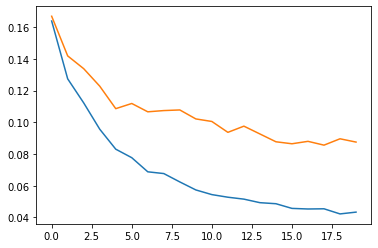

In [ ]:
plt.plot(np.arange(len(total_train_loss)),total_train_loss)
plt.plot(np.arange(len(total_valid_loss)),total_valid_loss)
plt.show()

### Test

In [ ]:
xa,xp,xn = gen_test[0]

xa.shape, xp.shape, xn.shape

In [ ]:
plt.figure(figsize=(16, 9))

xa_num = xa.numpy()
xp_num = xp.numpy()
xn_num = xn.numpy()

x = xa_num[0].transpose((1, 2, 0))
plt.subplot(3, 5, 1)
plt.title("anchor")
plt.imshow((x + mean)/255)
plt.axis('off')
    
x = xp_num[0].transpose((1, 2, 0))
plt.subplot(3, 5, 6)
plt.title("positive")
plt.imshow((x + mean) / 255)
plt.axis('off')
    
x = xn_num[0].transpose((1, 2, 0))
plt.subplot(3, 5, 11)
plt.title("negative")
plt.imshow((x + mean) / 255)
plt.axis('off')
    
plt.show()

In [ ]:
anchor_test = xa.to(device)
positive_test = xp.to(device)
negative_test = xn.to(device)
          
optimizer.zero_grad()

anchor_test_out = triplet_learner(anchor_test)
positive_test_out = triplet_learner(positive_test)
negative_test_out = triplet_learner(negative_test)

test_loss = criterion(anchor_test_out, positive_test_out, negative_test_out)

In [ ]:
test_loss

### Load Model

In [ ]:
df["Name"].value_counts()

George_W_Bush            524
Colin_Powell             236
Tony_Blair               144
Donald_Rumsfeld          118
Gerhard_Schroeder        108
                        ... 
Bill_King                  1
Raul_Cubas                 1
Barry_Nakell               1
Adriana_Perez_Navarro      1
David_Welch                1
Name: Name, Length: 5721, dtype: int64

In [ ]:
model = TripletLearner()
model.load_state_dict(torch.load("./model3.pth"))
model.eval()

TripletLearner(
  (conv): Sequential(
    (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (1): ReLU()
    (2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (3): ReLU()
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (6): ReLU()
    (7): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (8): ReLU()
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (11): ReLU()
    (12): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (13): ReLU()
    (14): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (15): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (16): ReLU()
    (17): Conv2d(64, 32, kernel_size=(3, 3), stride=(1, 1), padding

In [ ]:
model = model.to(device)

### Build threshold

In [ ]:
list_classids = random.sample(range(0,num_classes), 2)
id1 = df.Id[df.Classid==list_classids[0]].iloc[random.randint(0,len(df.Id[df.Classid==list_classids[0]]))-1]
print(list_classids)
print(df.Id[df.Classid==list_classids[0]])
print(id1)

[4250, 3254]
9881    9935
Name: Id, dtype: object
9935


In [ ]:
Xa_pos, Xp_pos = build_positive_pairs(df, range(split_train_test, indiv_max-1))
nb_pairs = len(build_positive_pairs(df, range(split_train_test, indiv_max-1))[0])
Xa_neg, Xp_neg = build_negative_pairs(df, range(split_train_test, indiv_max-1),nb_pairs)

all_img_pos_idx = list(set(Xa_pos) | set(Xp_pos))
all_img_neg_idx = list(set(Xa_neg) | set(Xp_neg))

In [ ]:
Xa_pos_train, Xp_pos_train = build_positive_pairs(df, range(0, split_train_test-1))
nb_pairs_train = len(build_positive_pairs(df, range(0, split_train_test-1))[0])
Xa_neg_train, Xp_neg_train = build_negative_pairs(df, range(0, split_train_test-1),nb_pairs_train)

all_img_pos_idx_train = list(set(Xa_pos_train) | set(Xp_pos_train))
all_img_neg_idx_train = list(set(Xa_neg_train) | set(Xp_neg_train))

In [ ]:
len(Xa_pos_train),len(Xp_pos_train),len(Xa_neg_train),len(Xp_neg_train)

(11769, 11769, 11769, 11769)

In [ ]:
Xa_pos_train = Xa_pos_train[:1000]
Xp_pos_train = Xp_pos_train[:1000]
Xa_neg_train = Xa_neg_train[:1000]
Xp_neg_train = Xp_neg_train[:1000]

TO DO print files names

positive pair


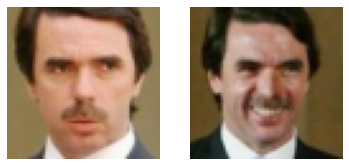

negative pair


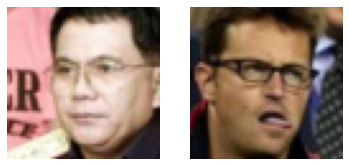

In [ ]:
print('positive pair')
print_pairs(df, Xa_pos_train, Xp_pos_train, 0)
print('negative pair')
print_pairs(df, Xa_neg_train, Xp_neg_train, 0)

In [ ]:
# gen_pos = TripletGenerator(Xa_pos, Xp_pos, BATCH_TEST_SIZE, all_imgs, all_img_train_idx)
# pos_loader = DataLoader(gen_pos, batch_size=None, shuffle=True)

# gen_neg = TripletGenerator(Xa_neg, Xp_neg, BATCH_TEST_SIZE, all_imgs, all_img_train_idx)
# neg_loader = DataLoader(gen_neg, batch_size=None, shuffle=True)

In [ ]:
gen_pos = TripletGenerator(Xa_pos_train, Xp_pos_train, 1, all_imgs, all_img_train_idx)
pos_loader = DataLoader(gen_pos, batch_size=None, shuffle=True)

gen_neg = TripletGenerator(Xa_neg_train, Xp_neg_train, 1, all_imgs, all_img_train_idx)
neg_loader = DataLoader(gen_neg, batch_size=None, shuffle=True)

In [ ]:
pos_loss, running_pos_loss = testing(pos_loader, device, 10, model, criterion)

Epoch: 1/10 - Loss: 0.0327


Epoch: 2/10 - Loss: 0.0334


Epoch: 3/10 - Loss: 0.0375


Epoch: 4/10 - Loss: 0.0371


Epoch: 5/10 - Loss: 0.0351


Epoch: 6/10 - Loss: 0.0328


Epoch: 7/10 - Loss: 0.0339


Epoch: 8/10 - Loss: 0.0330


Epoch: 9/10 - Loss: 0.0350


Epoch: 10/10 - Loss: 0.0325



In [ ]:
neg_loss, running_neg_loss = testing(neg_loader, device, 10, model, criterion)

Epoch: 1/10 - Loss: 0.3198


Epoch: 2/10 - Loss: 0.3352


Epoch: 3/10 - Loss: 0.3489


Epoch: 4/10 - Loss: 0.3280


Epoch: 5/10 - Loss: 0.3261


Epoch: 6/10 - Loss: 0.3325


Epoch: 7/10 - Loss: 0.3448


Epoch: 8/10 - Loss: 0.3076


Epoch: 9/10 - Loss: 0.3333


Epoch: 10/10 - Loss: 0.3262



In [ ]:
def print_hist(pos_loss, neg_loss):
    fig,ax = plt.subplots(1,1,figsize=(6,3),dpi=100,num=1)
    bins=np.linspace(0.,1,30)
    plt.hist(pos_loss,bins=bins,label='positive loss', alpha=0.3)
    plt.hist(neg_loss,bins=bins,label='negative loss', alpha=0.3)
    # plt.xlim([0.,1.])
    plt.legend()
    plt.show()

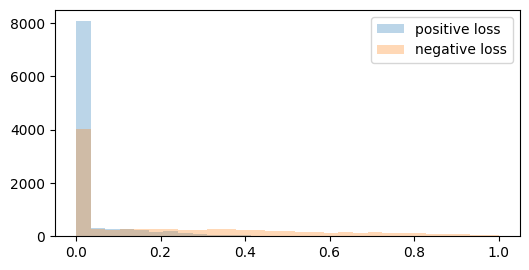

In [ ]:
print_hist(running_pos_loss,running_neg_loss)

In [ ]:
max_pos = max(running_pos_loss)
min_neg = min(running_neg_loss)
print("maximum loss for positive pairs: ", max_pos)
print("minimum loss for negative pairs: ", min_neg)

maximum loss for positive pairs:  0.15340737
minimum loss for negative pairs:  0.14264192


In [ ]:
THRESHOLD = (max_pos+min_neg)/2
print("Threshold: ", THRESHOLD)

Threshold:  0.14802464842796326


In [ ]:
def sigmoid(x, c1, c2):
  
    z = np.exp(-c1*(x-c2))
    sig = 1 / (1 + z)

    return sig

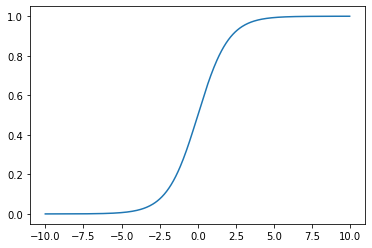

In [ ]:
xx = np.arange(-10,10,0.05)
plt.plot(xx,sigmoid(xx,1.,0.))
plt.show()

No handles with labels found to put in legend.


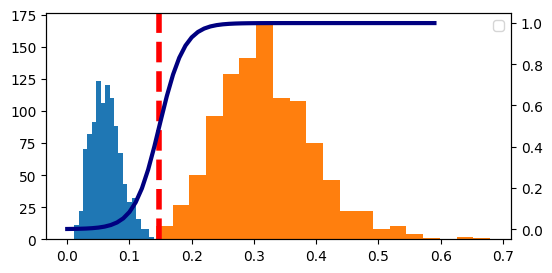

In [ ]:
fig,ax1 = plt.subplots(1,1,figsize=(6,3),dpi=100,num=1)
ax1.hist(running_pos_loss,bins=20,label='positive loss')
ax1.hist(running_neg_loss,bins=20,label='negative loss')
ax1.axvline(x=THRESHOLD, color="red", linestyle="--", lw=4)
ax2 = ax1.twinx()
xx = np.arange(0,0.6,0.01)
ax2.plot(xx, sigmoid(xx, 50., THRESHOLD),color='navy',lw=3)
plt.legend()
plt.show()

In [ ]:
def authentification_id(df, id_img1, id_img2, neg_imgs_idx, threshold):

    id_img3 = neg_imgs_idx[random.randint(0,len(neg_imgs_idx)-1)]

    img1 = df.Img.iloc[id_img1]
    img2 = df.Img.iloc[id_img2]
    img3 = df.Img.iloc[id_img3]

    image_transforms = transforms.Compose(
              [
                  transforms.ToTensor(),
              ]
          )

    anchor_img = torch.reshape(image_transforms(img1).to(device).float(), (1,3,60,60))
    positive_img = torch.reshape(image_transforms(img2).to(device).float(), (1,3,60,60))
    negative_img = torch.reshape(image_transforms(img3).to(device).float(), (1,3,60,60))

    anchor_out = model(anchor_img)
    positive_out = model(positive_img)
    negative_out = model(negative_img)

    loss = criterion(anchor_out, positive_out, negative_out)
    print("Loss: ", loss.cpu().detach().numpy())

    if loss < threshold :
        return 1
    
    return 0

ARE SUPPOSED TO BE ALWAYS DIFFERENT
Loss:  0.19867907


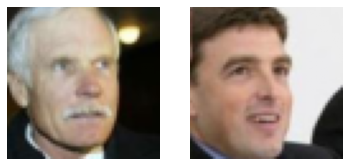

Different people


In [ ]:
### ARE SUPPOSED TO BE ALWAYS DIFFERENT

print("ARE SUPPOSED TO BE ALWAYS DIFFERENT")

rdm = random.randint(0,len(Xa_pos))
id1 = Xa_neg[rdm]
id2 = Xp_neg[rdm]

bin = authentification_id(df, id1, id2, all_img_neg_idx, THRESHOLD)

xa = np.zeros((1))
xp = np.zeros((1))

xa[0]=id1
xp[0]=id2

print_pairs(df, xa, xp, 0)

if bin==1 :
    print("Same person")
else :
    print("Different people")

ARE SUPPOSED TO BE ALWAYS THE SAME
Loss:  0.0


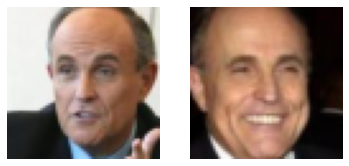

Same person


In [ ]:
### ARE SUPPOSED TO BE ALWAYS THE SAME

print("ARE SUPPOSED TO BE ALWAYS THE SAME")

rdm = random.randint(0,len(Xa_pos))
id1 = Xa_pos[rdm]
id2 = Xp_pos[rdm]

bin = authentification_id(df, id1, id2, all_img_neg_idx, THRESHOLD)

xa = np.zeros((1))
xp = np.zeros((1))

xa[0]=id1
xp[0]=id2

print_pairs(df, xa, xp, 0)

if bin==1 :
    print("Same person")
else :
    print("Different people")

In [ ]:
def authentification_img(df, img1, img2, neg_imgs_idx, threshold, proba=False):

    id_img3 = neg_imgs_idx[random.randint(0,len(neg_imgs_idx)-1)]
    img3 = df.Img.iloc[id_img3]

    img1 = img1.to(device).float()
    img2 = img2.to(device).float()

    image_transforms = transforms.Compose(
              [
                  transforms.ToTensor(),
              ]
          )
    
    img3 = image_transforms(img3).to(device).float()

    anchor_img = torch.reshape(img1, (1,3,60,60))
    positive_img = torch.reshape(img2, (1,3,60,60))
    negative_img = torch.reshape(img3, (1,3,60,60))

    anchor_out = model(anchor_img)
    positive_out = model(positive_img)
    negative_out = model(negative_img)

    loss = criterion(anchor_out, positive_out, negative_out)
    loss = loss.cpu().detach().numpy()
    # print("Loss: ", loss)

    if proba == True :
        return 1-sigmoid(loss, 50., threshold)
    else :
        if loss < threshold :
            return 1
        
        return 0

In [ ]:
def predict(df, loader, neg_imgs_idx, threshold, proba=False):
    bins=[]
    for step, (anchor_img, positive_img, negative_img) in enumerate(tqdm(loader, desc="Processing", leave=False)):
        for img in range(len(anchor_img)):
            bins.append(authentification_img(df, anchor_img[img], positive_img[img], neg_imgs_idx, threshold, proba))
    return bins

In [ ]:
y_pred_pos = predict(df, pos_loader, all_img_neg_idx, THRESHOLD)
y_pred_neg = predict(df, neg_loader, all_img_neg_idx, THRESHOLD)

In [ ]:
y_proba_pos = predict(df, pos_loader, all_img_neg_idx, THRESHOLD, proba=True)
y_proba_neg = predict(df, neg_loader, all_img_neg_idx, THRESHOLD, proba=True)

In [ ]:
y_pos = [1 for _ in range(len(y_pred_pos))]
y_neg = [0 for _ in range(len(y_pred_neg))]

In [ ]:
y_pred = y_pred_pos + y_pred_neg
y_proba = y_proba_pos + y_proba_neg
y = y_pos + y_neg

Metrics

In [ ]:
from sklearn.metrics import confusion_matrix, auc, roc_curve, precision_recall_curve, f1_score

In [ ]:
print("Confusion Matrix Total")
confusion_matrix(y, y_pred)

Confusion Matrix Total


array([[1771, 1525],
       [ 602, 2694]])

In [ ]:
# help(confusion_matrix)

In [ ]:
fpr, tpr, _ = roc_curve(y, y_proba)
roc_auc = auc(fpr,tpr)

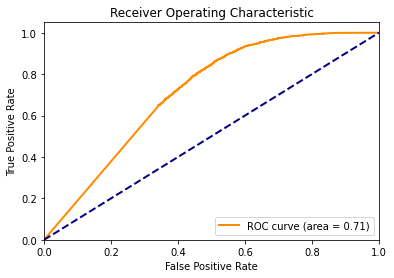

In [ ]:
plt.figure()
lw=2
plt.plot(fpr, tpr, color="darkorange", lw=lw, label="ROC curve (area = %0.2f)" % roc_auc)
plt.plot([0,1],[0,1], color="navy",lw=lw, linestyle="--")
plt.xlim([0.,1.])
plt.ylim([0.,1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Receiver Operating Characteristic")
plt.legend(loc="lower right")
plt.show()

In [ ]:
precision, recall, thresholds = precision_recall_curve(y, y_proba)

Logistic: f1=0.717 auc=0.755


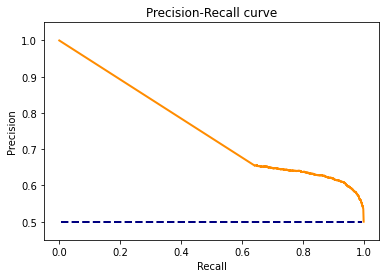

In [ ]:
f1_s, auc_s = f1_score(y, y_pred), auc(recall, precision)
print('Logistic: f1=%.3f auc=%.3f' % (f1_s, auc_s))

plt.figure()
lw=2
plt.plot(recall, precision, color="darkorange", lw=lw, label="Precision-Recall curve")
plt.axhline(y=0.5, xmin=0.05, xmax=0.95, color="navy", linestyle="--", lw=lw)
plt.ylim([0.45,1.05])
plt.xlim([-0.05,1.05])
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall curve")
plt.show()

Missclassified examples

In [ ]:
from skimage.io import imread
from skimage.transform import resize

def resize100(img):
    return resize(img, (100, 100), preserve_range=True, mode='reflect', anti_aliasing=True)[20:80,20:80,:]

In [ ]:
mean = np.array([131.60774134, 105.40847531,  88.49154859])

FALSE NEGATIVES


3


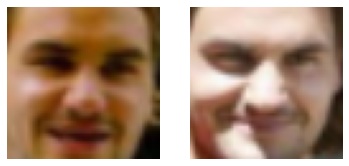

4


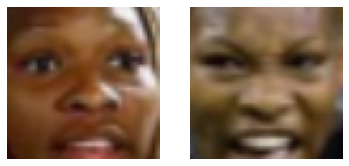

10


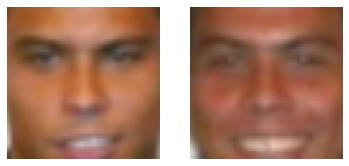

11


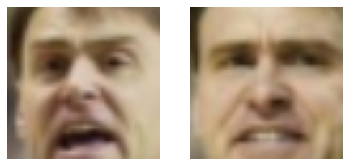

13


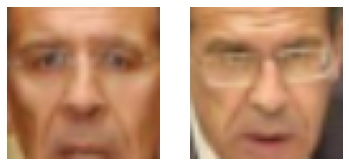

21


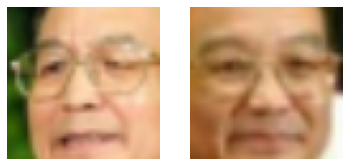

26


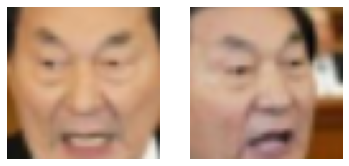

42


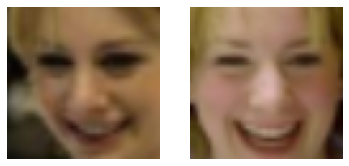

44


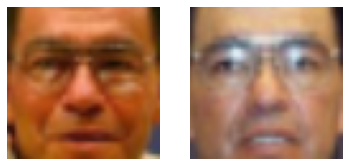

56


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


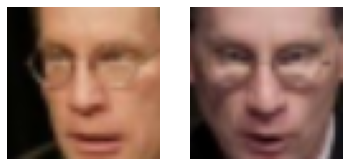

64


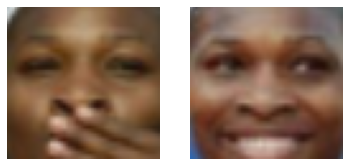

65


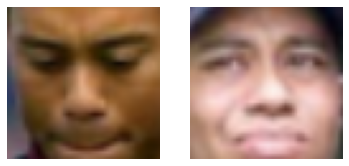

68


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


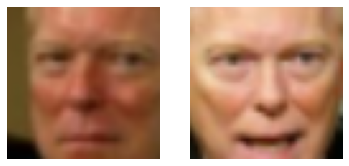

69


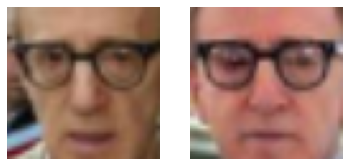

71


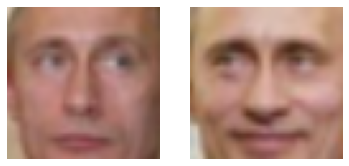

79


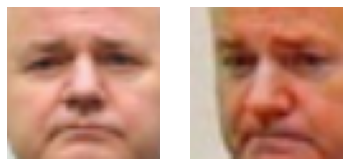

83


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


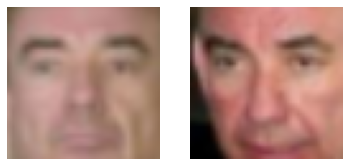

86


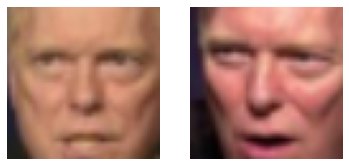

87


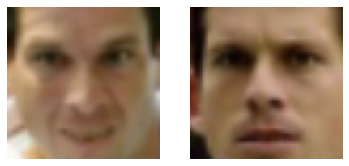

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


91


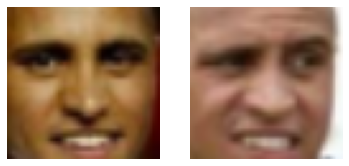

95


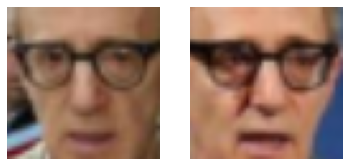

115


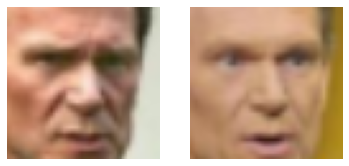

122


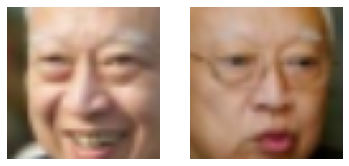

124


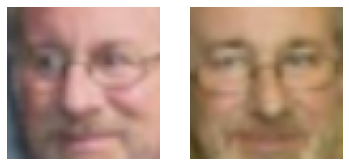

126


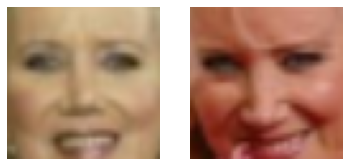

129


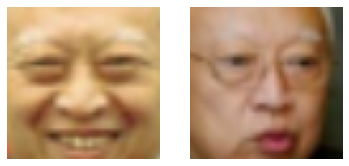

133


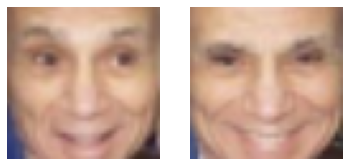

154


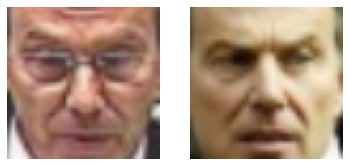

156


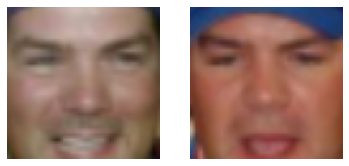

165


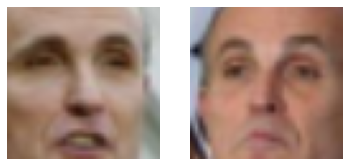

175


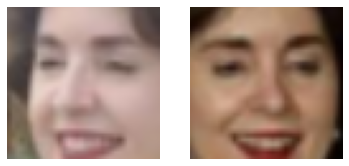

192


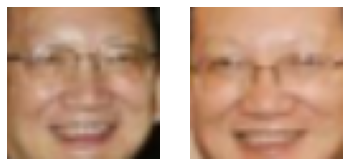

197


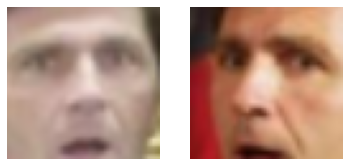

212


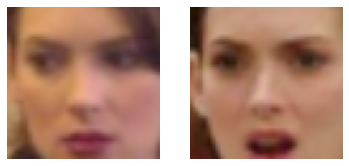

219


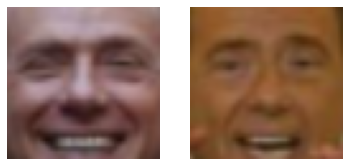

221


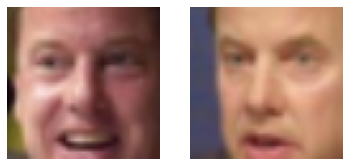

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


222


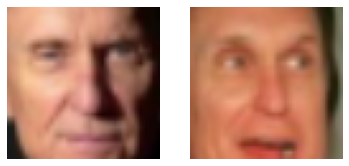

225


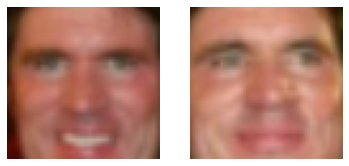

226


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


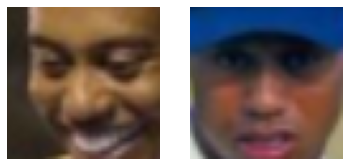

229


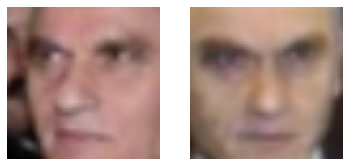

237


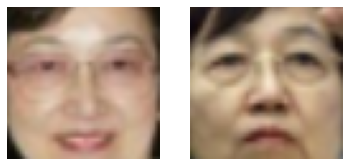

247


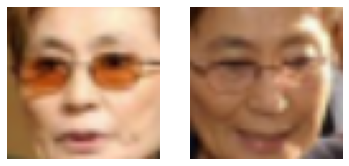

248


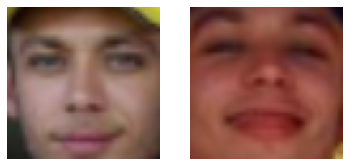

252


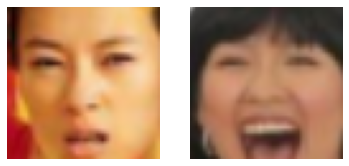

257


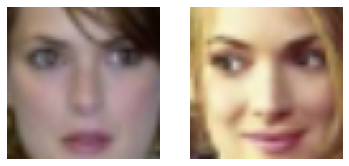

263


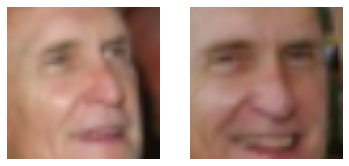

264


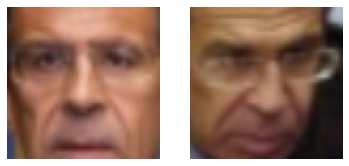

269


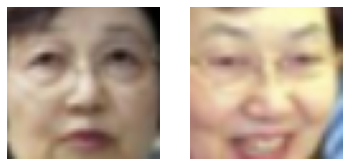

272


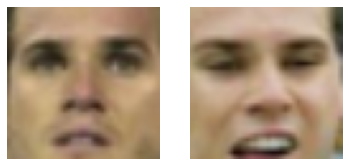

275


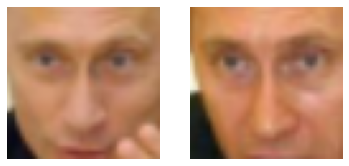

277


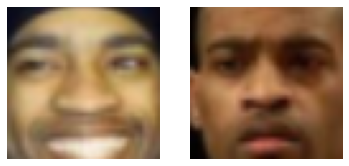

279


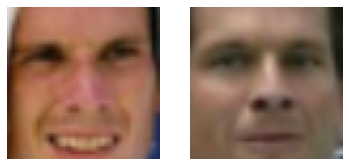

280


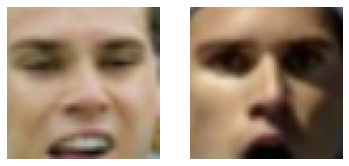

283


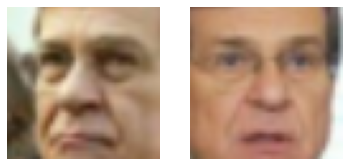

287


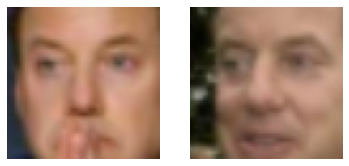

294


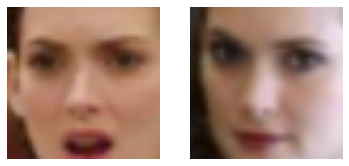

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


302


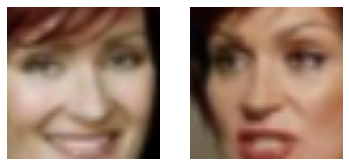

308


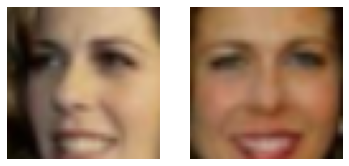

314


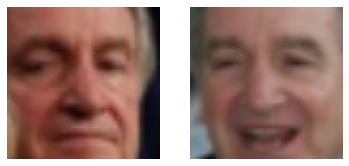

316


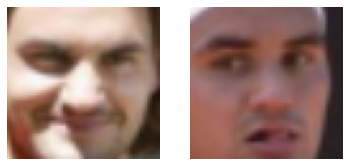

318


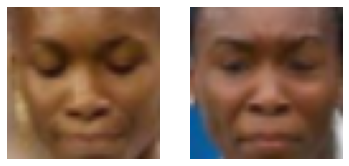

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


332


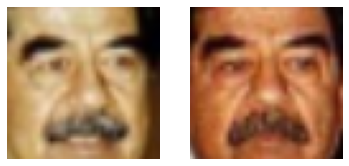

335


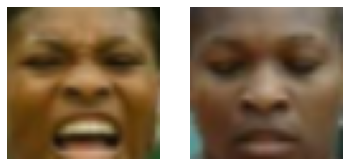

347


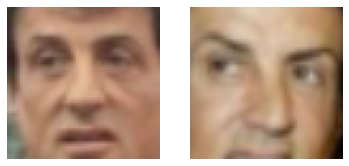

349


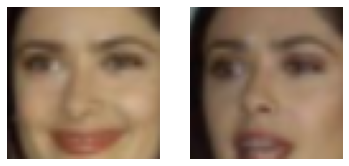

350


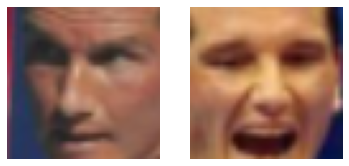

358


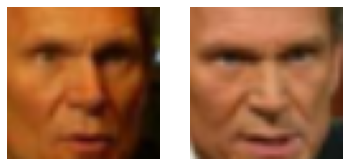

360


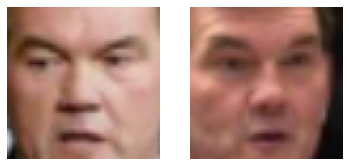

368


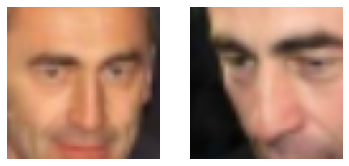

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


371


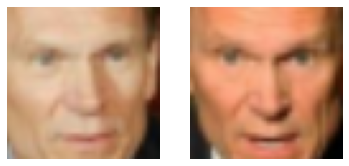

376


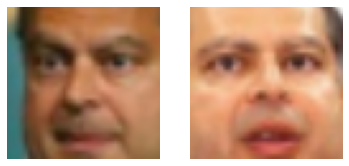

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


377


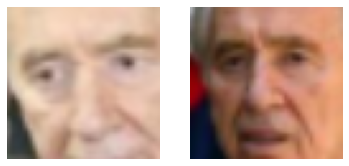

380


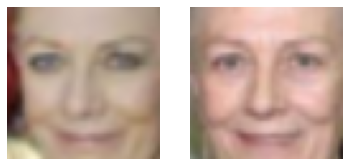

384


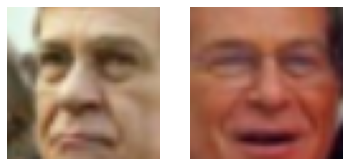

386


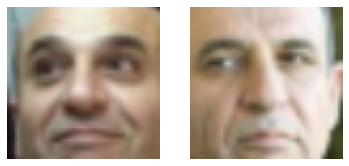

391


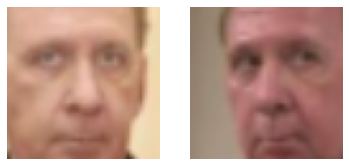

392


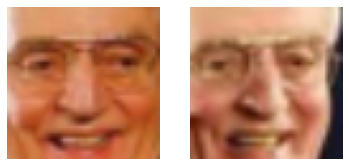

393


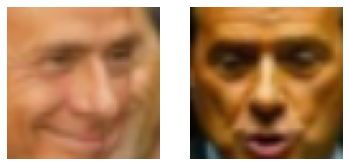

395


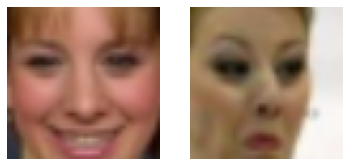

401


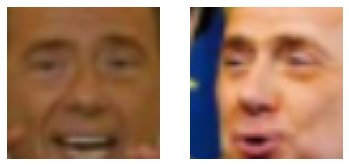

405


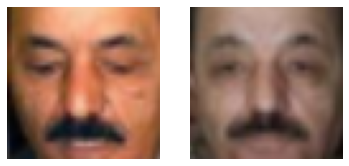

410


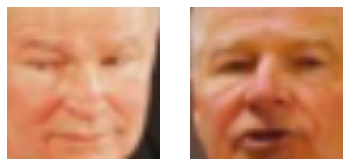

411


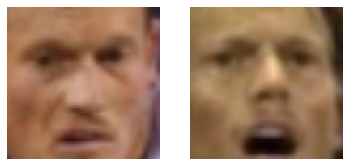

419


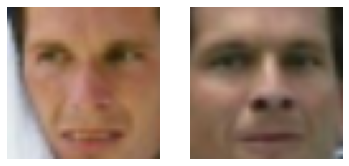

420


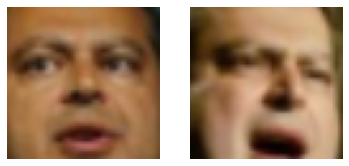

422


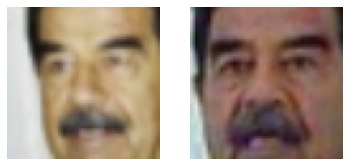

453


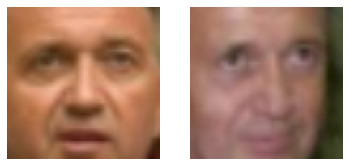

454


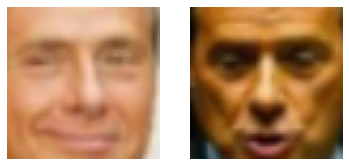

457


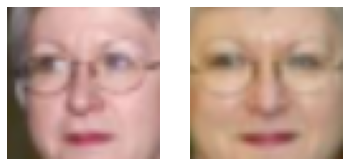

459


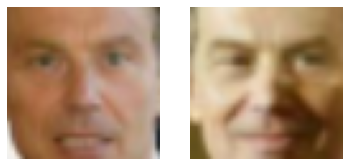

469


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


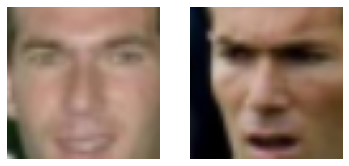

470


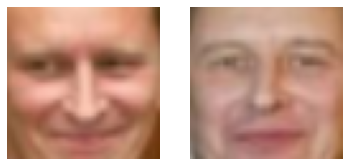

475


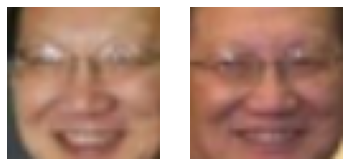

477


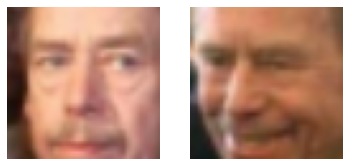

478


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


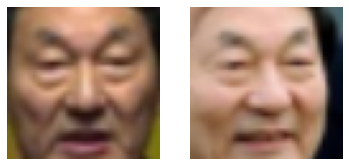

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


479


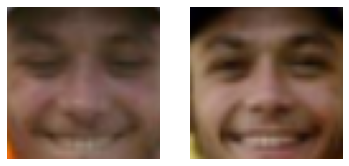

481


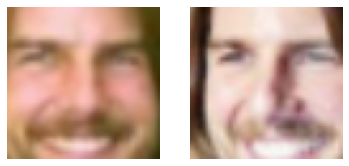

493


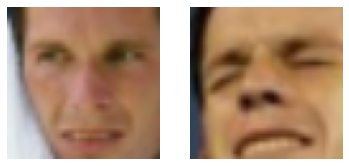

496


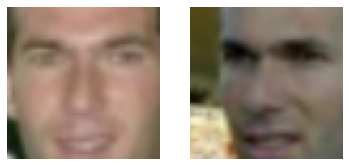

509


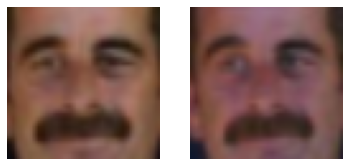

512


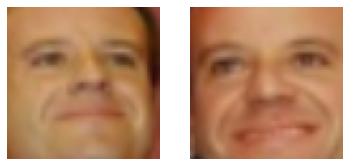

513


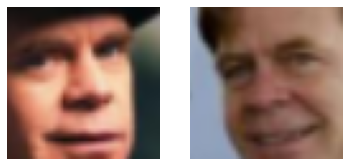

514


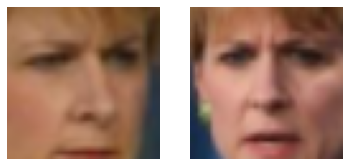

520


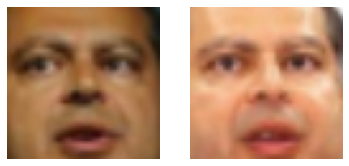

521


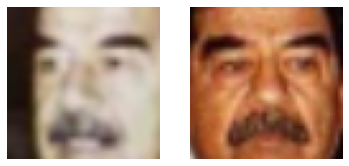

533


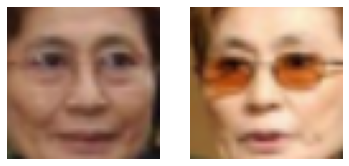

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


534


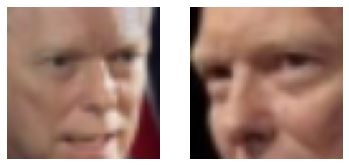

535


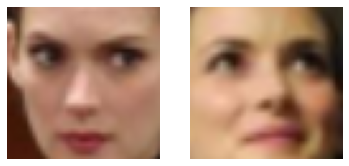

555


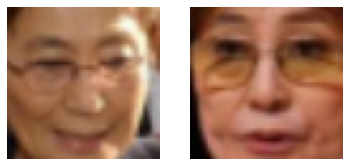

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


561


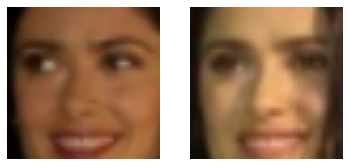

562


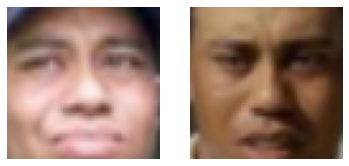

569


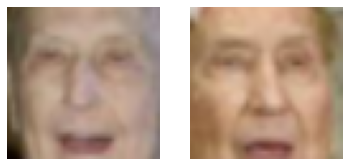

583


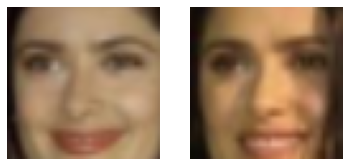

616


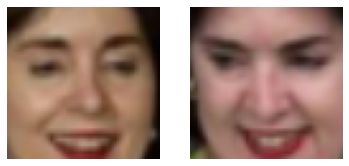

619


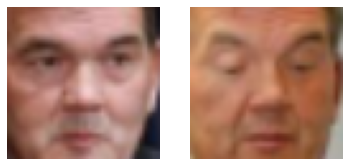

629


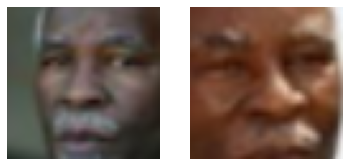

636


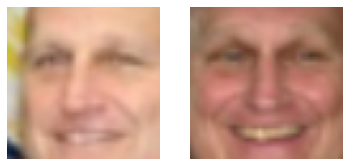

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


637


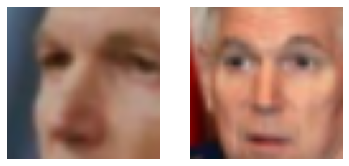

649


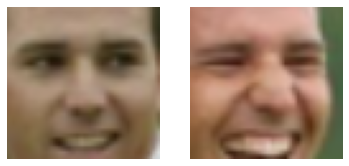

652


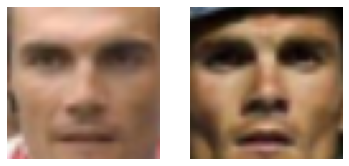

659


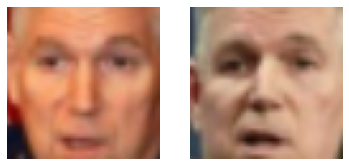

669


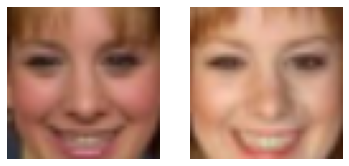

680


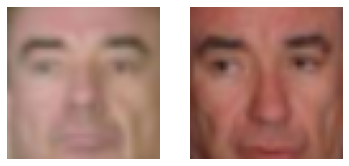

681


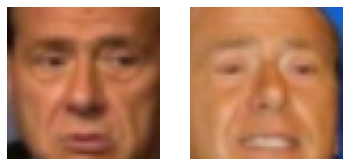

688


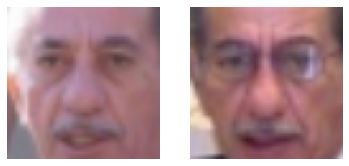

695


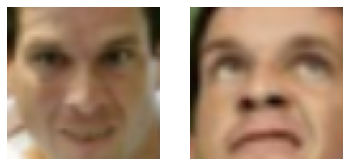

696


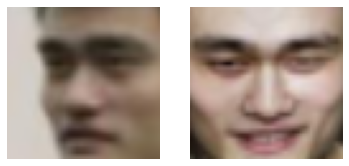

697


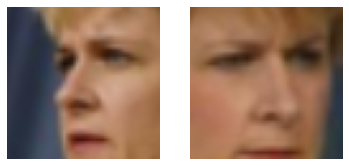

699


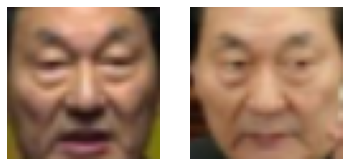

702


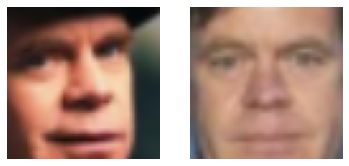

707


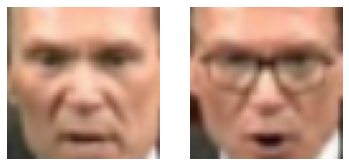

710


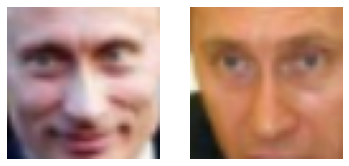

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


725


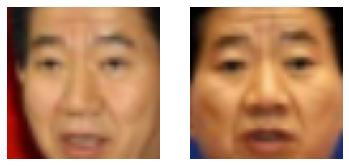

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


727


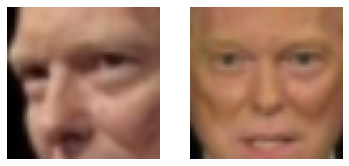

734


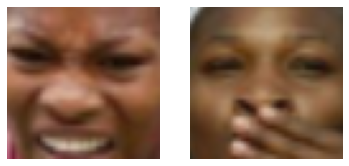

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


737


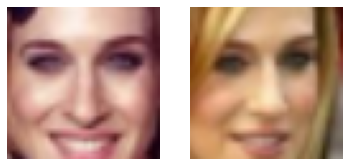

739


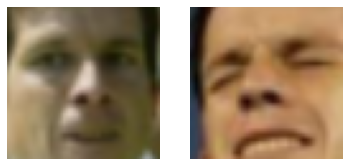

744


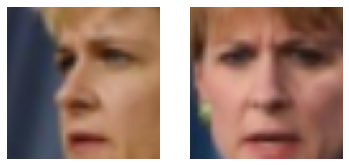

747


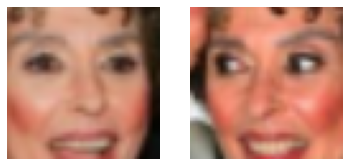

756


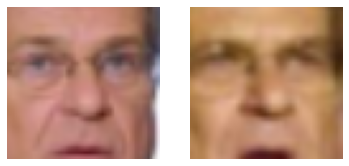

759


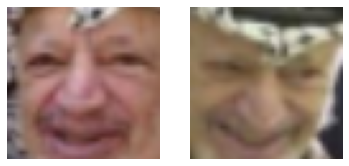

764


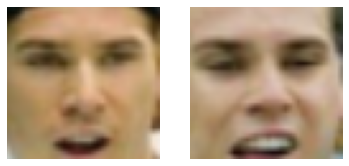

767


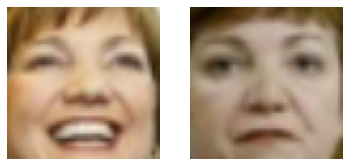

776


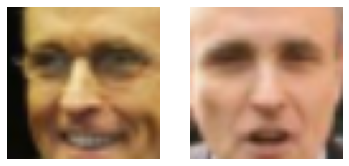

783


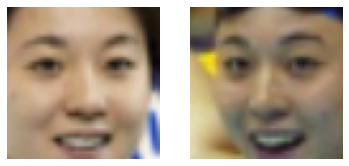

790


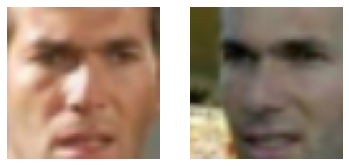

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


809


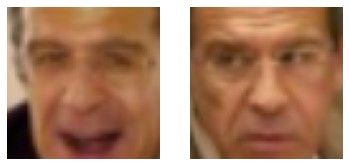

811


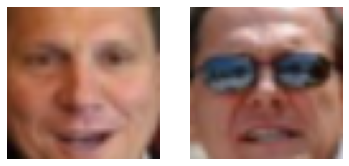

815


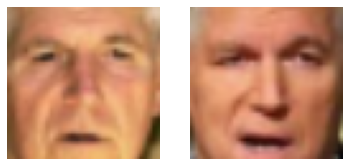

817


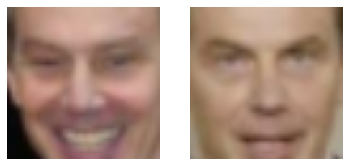

825


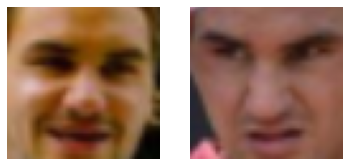

832


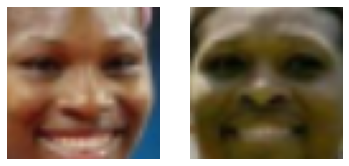

833


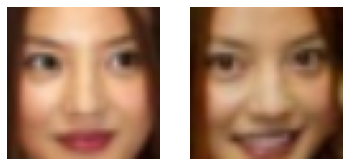

839


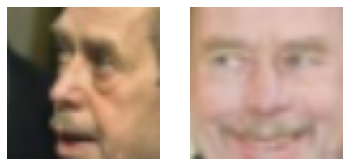

852


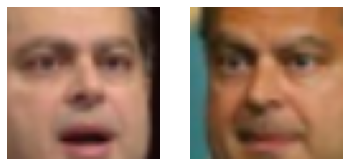

874


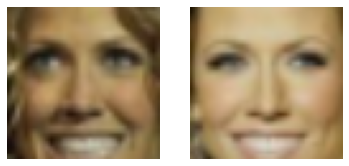

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


883


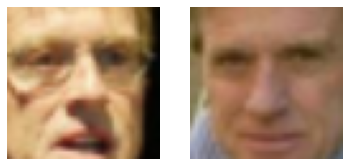

890


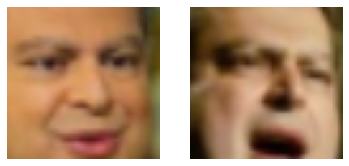

891


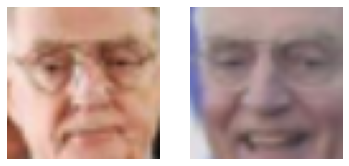

911


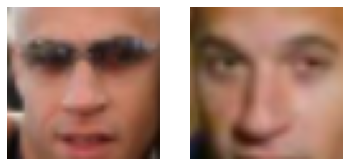

913


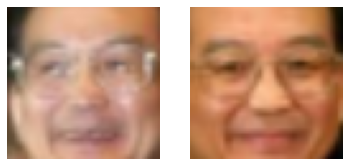

920


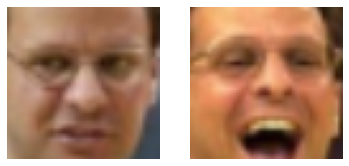

923


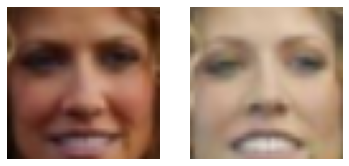

924


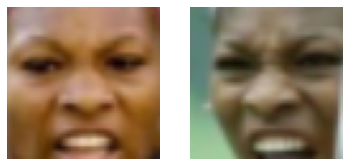

925


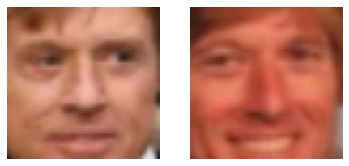

929


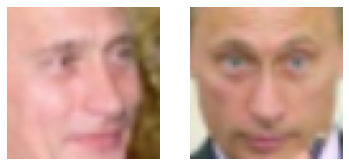

958


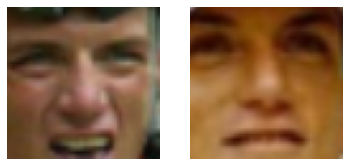

959


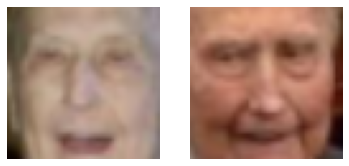

960


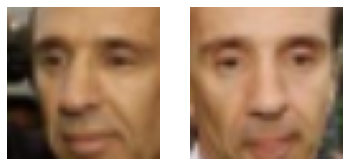

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


967


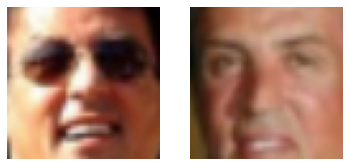

969


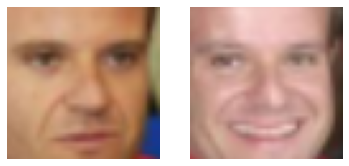

972


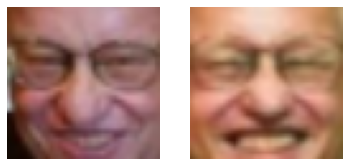

975


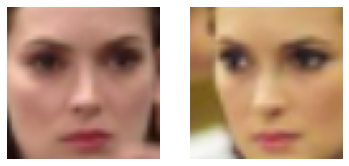

976


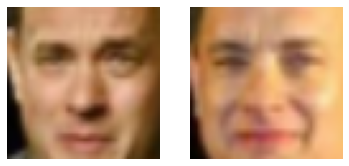

983


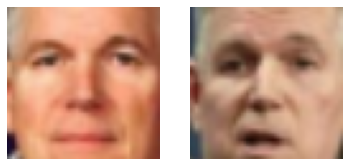

987


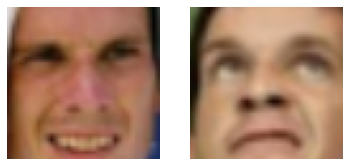

989


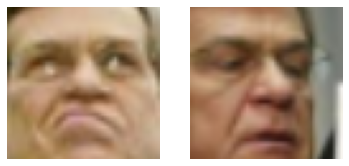

992


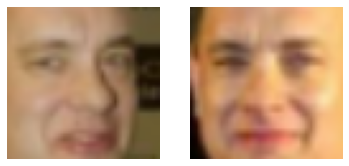

1008


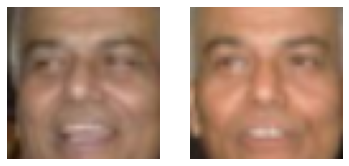

1009


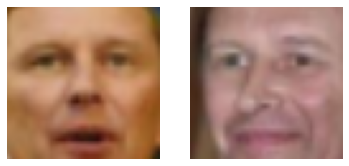

1013


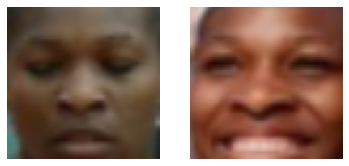

1027


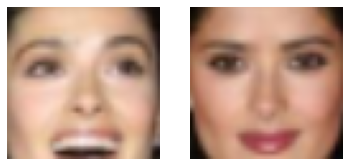

1033


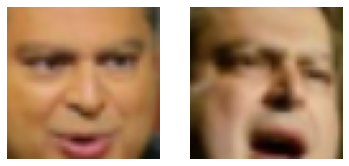

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1039


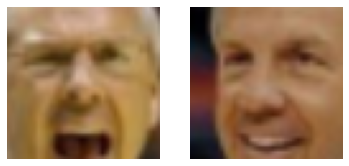

1044


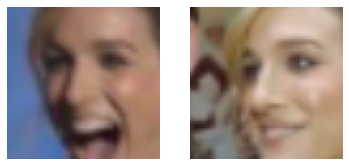

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1050


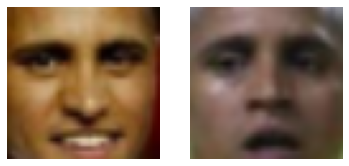

1051


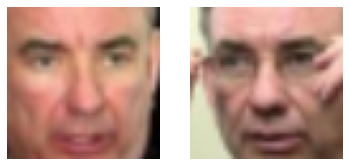

1056


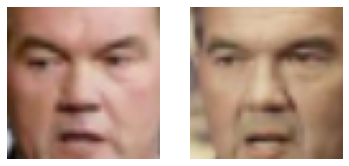

1060


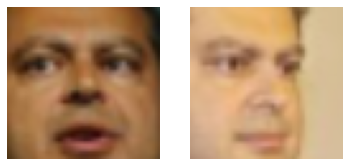

1062


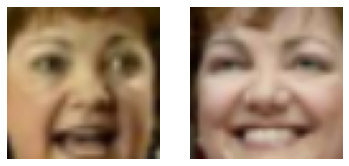

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1071


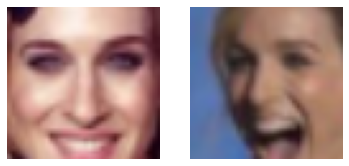

1082


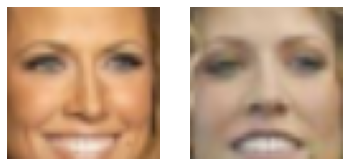

1083


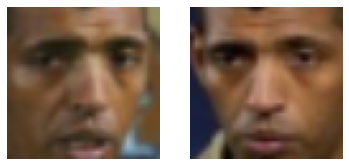

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1085


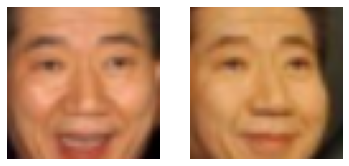

1086


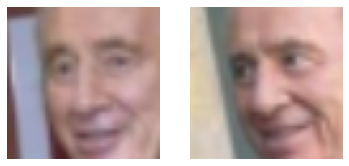

1105


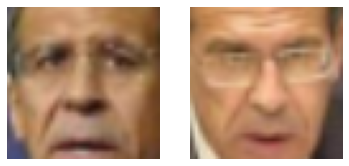

1108


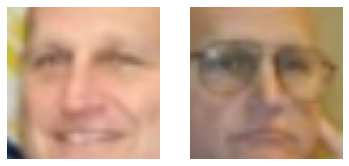

1120


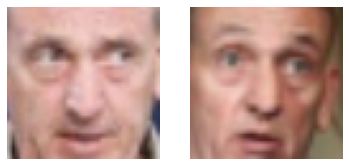

1128


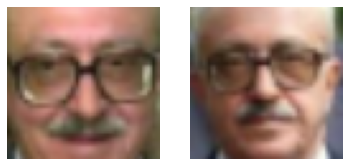

1129


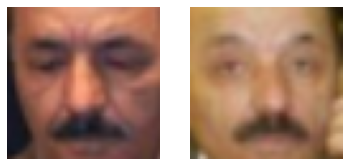

1130


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


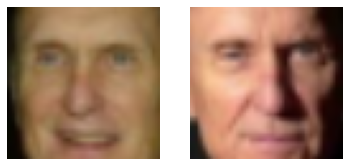

1133


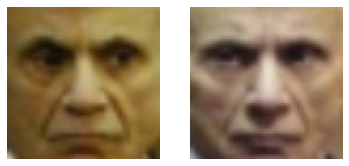

1138


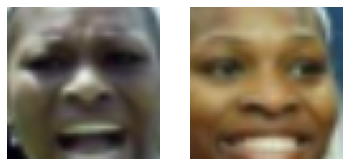

1139


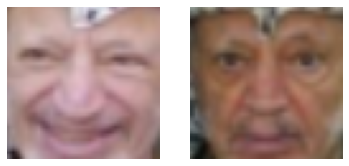

1150


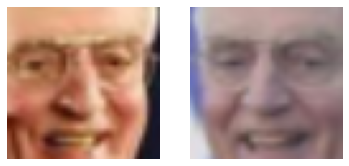

1153


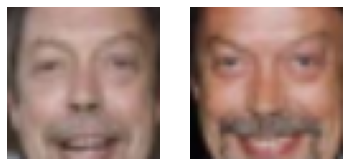

1157


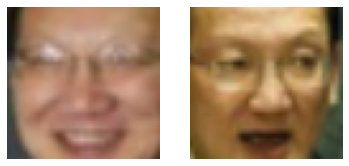

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1160


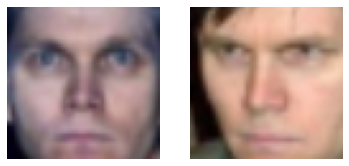

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1162


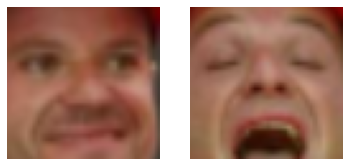

1172


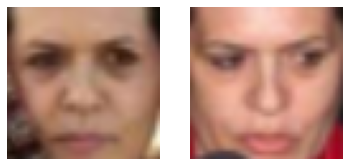

1173


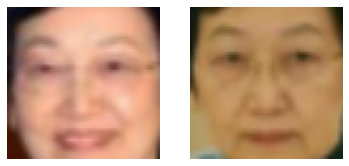

1179


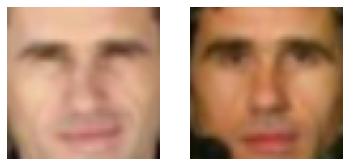

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1190


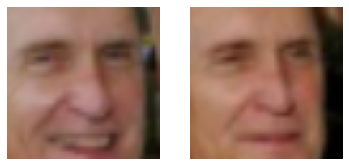

1201


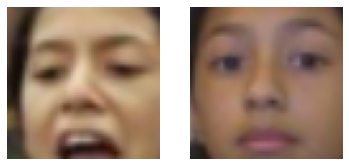

1203


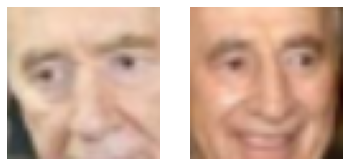

1214


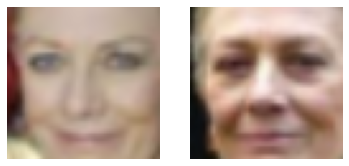

1228


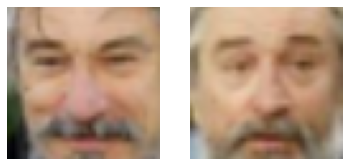

1234


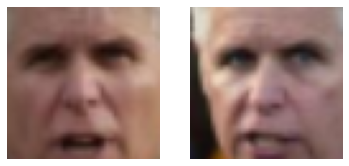

1238


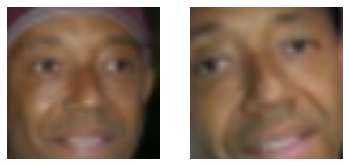

1252


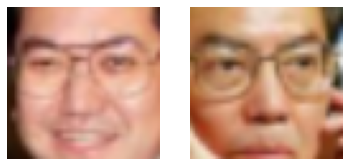

1258


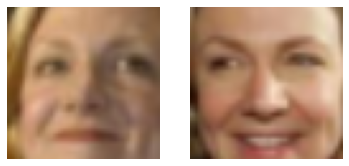

1266


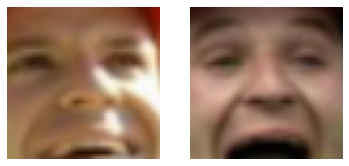

1268


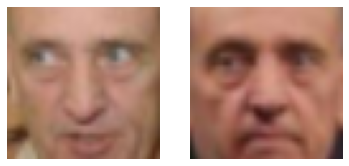

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1271


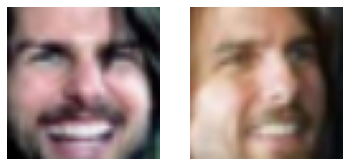

1272


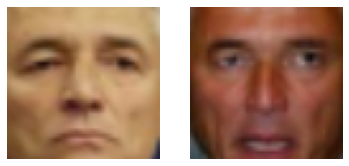

1286


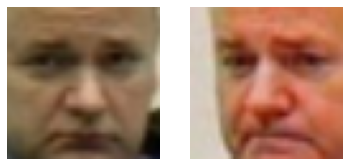

1296


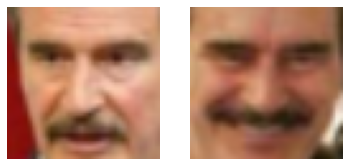

1301


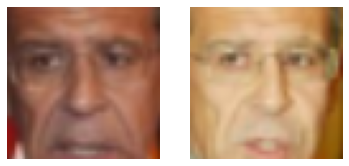

1315


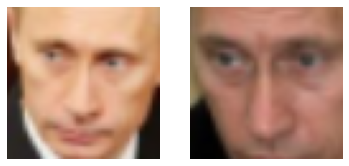

1316


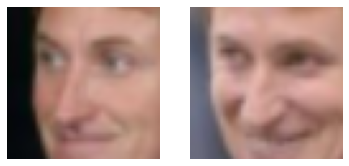

1323


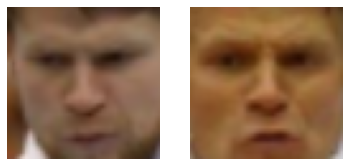

1325


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


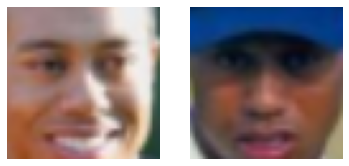

1334


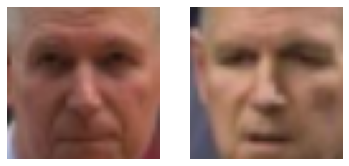

1337


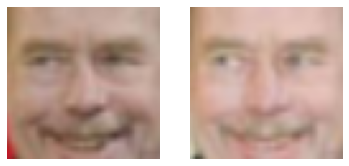

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1341


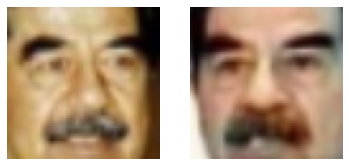

1343


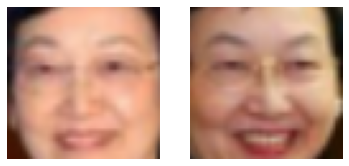

1352


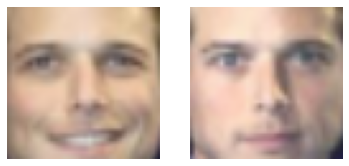

1357


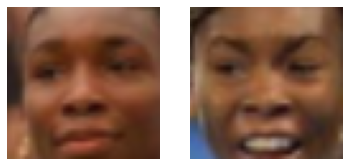

1358


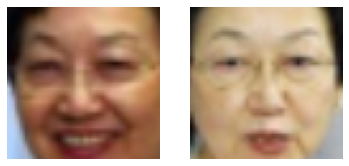

1379


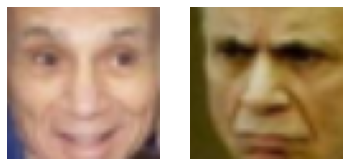

1383


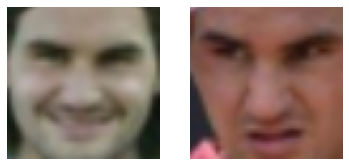

1389


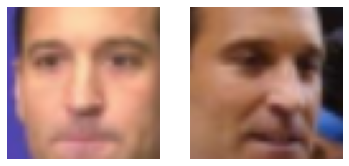

1397


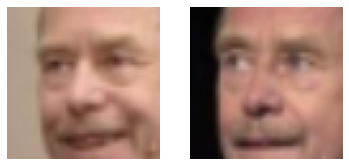

1408


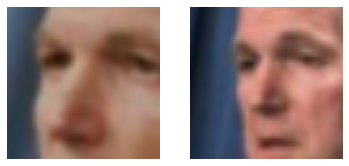

1411


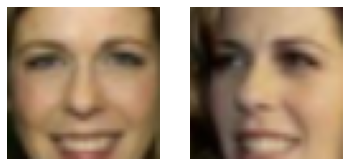

1414


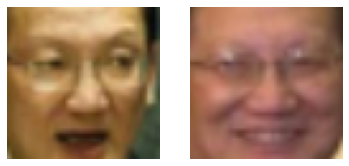

1415


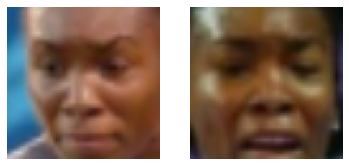

1418


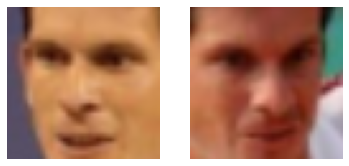

1419


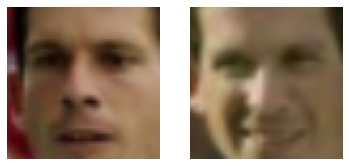

1426


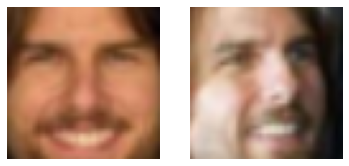

1430


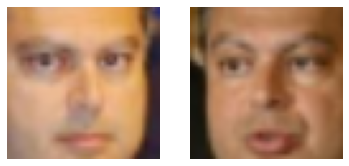

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1436


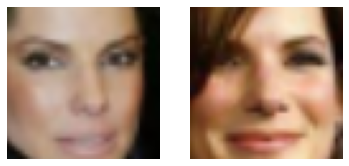

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1438


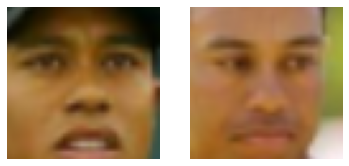

1445


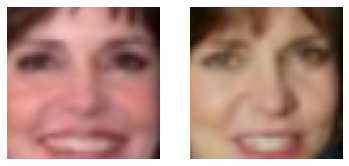

1452


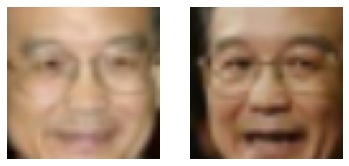

1460


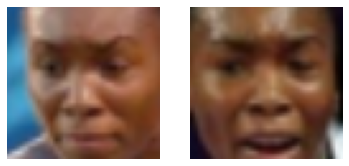

1463


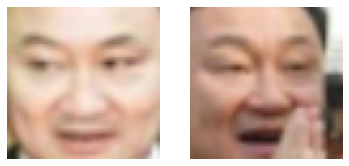

1467


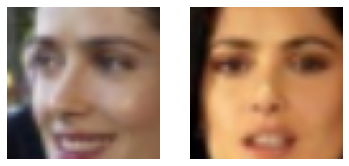

1470


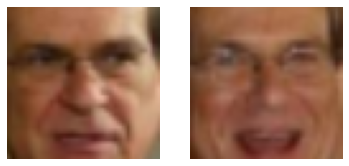

1473


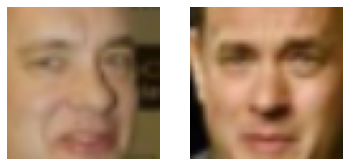

1483


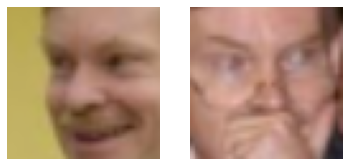

1488


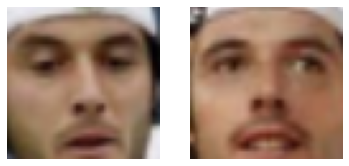

1496


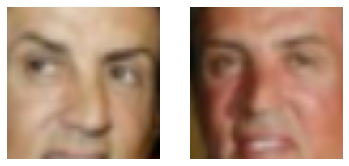

1498


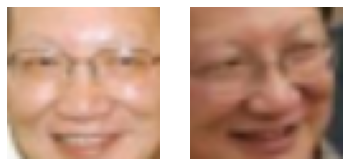

1505


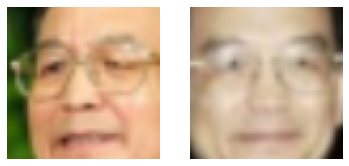

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1506


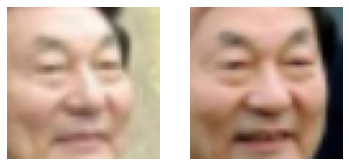

1513


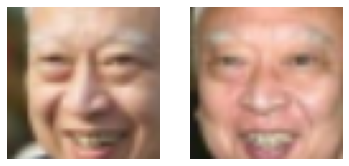

1531


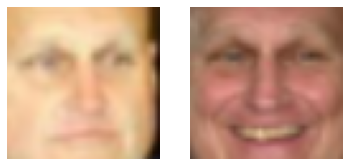

1532


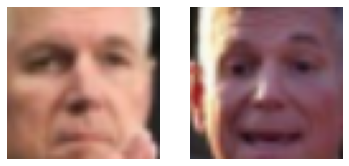

1543


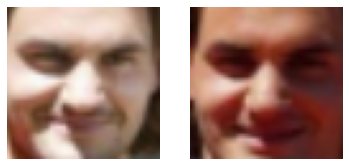

1546


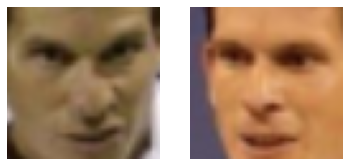

1547


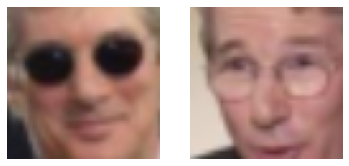

1551


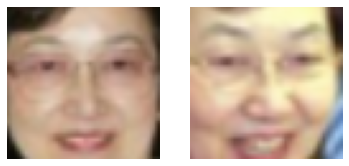

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1553


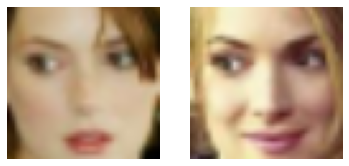

1556


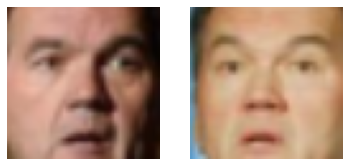

1560


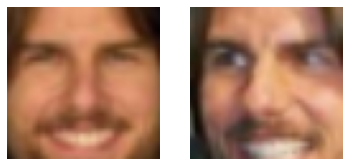

1564


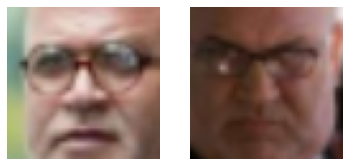

1571


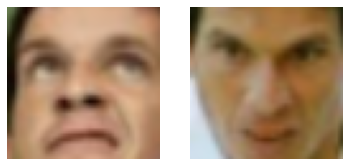

1590


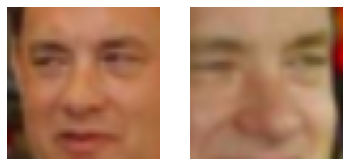

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1593


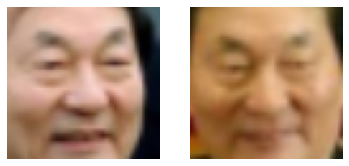

1594


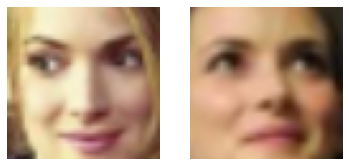

1603


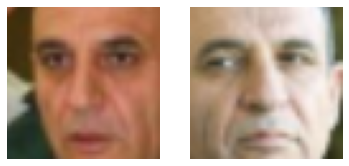

1610


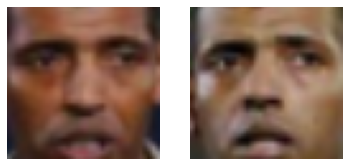

1633


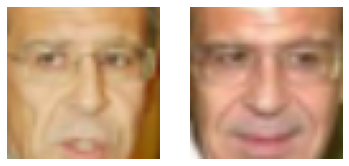

1643


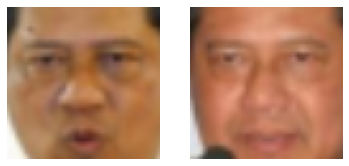

1653


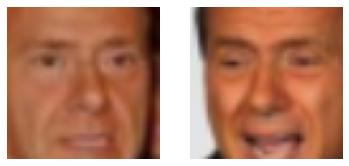

1655


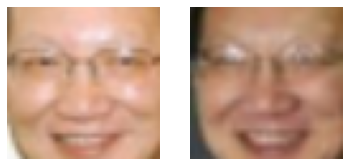

1660


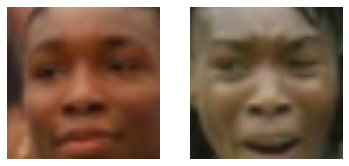

1674


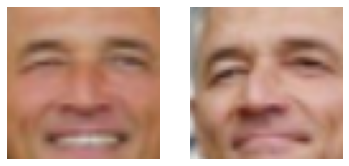

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1677


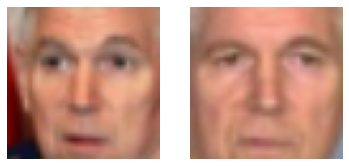

1680


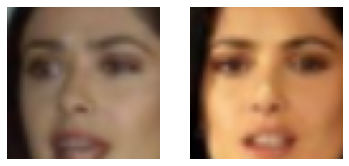

1681


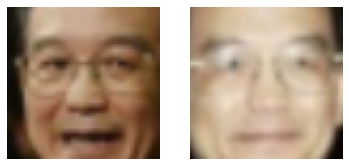

1686


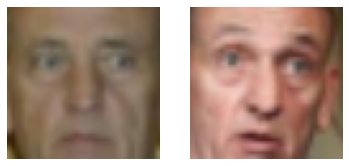

1694


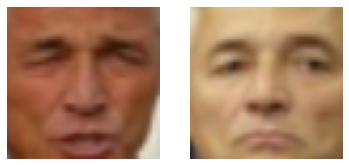

1700


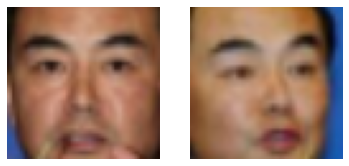

1708


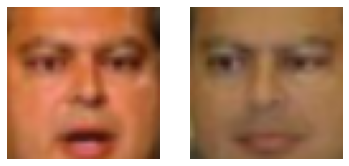

1709


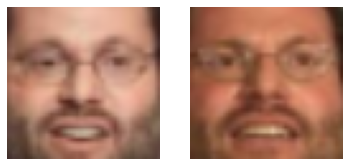

1711


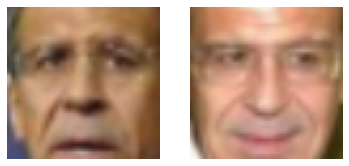

1714


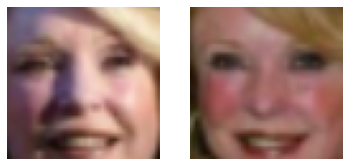

1716


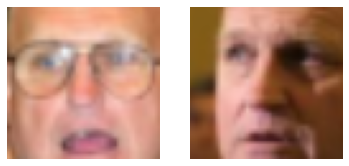

1719


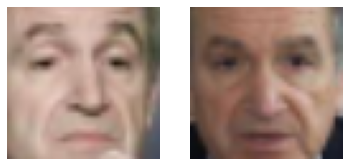

1720


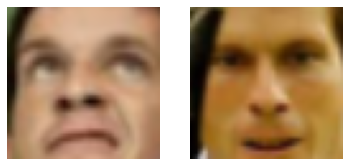

1728


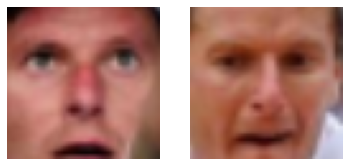

1729


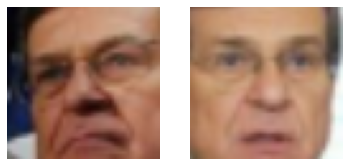

1736


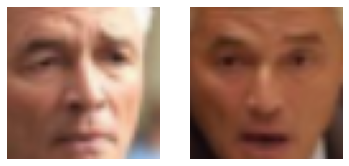

1737


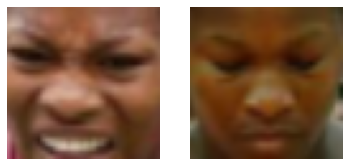

1738


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


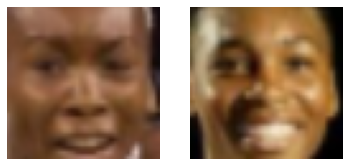

1740


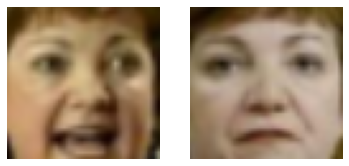

1744


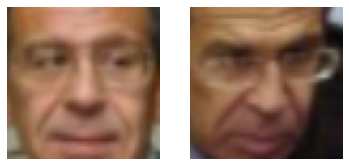

1745


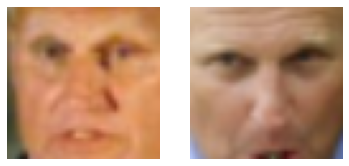

1757


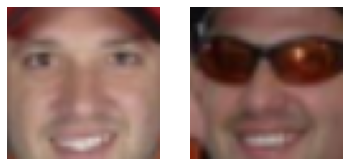

1758


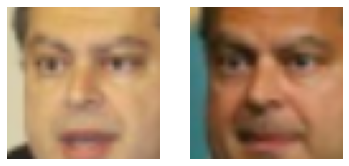

1763


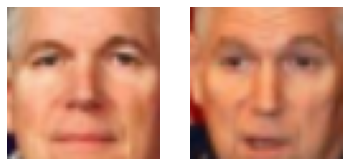

1765


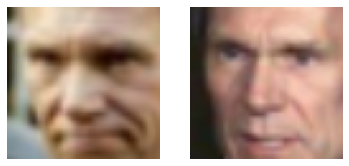

1771


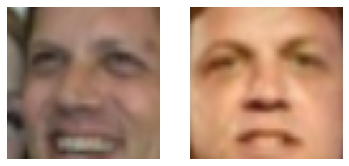

1796


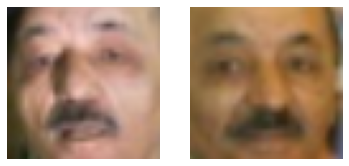

1799


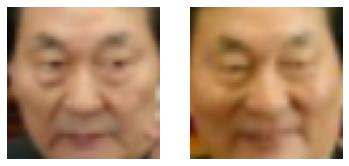

1813


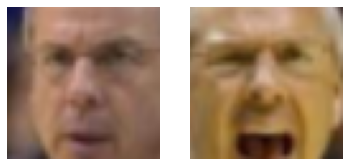

1814


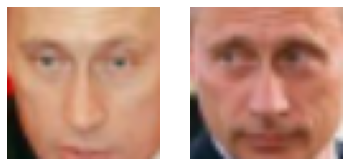

1818


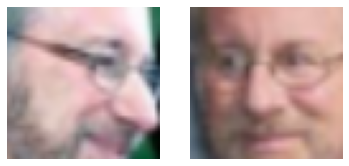

1821


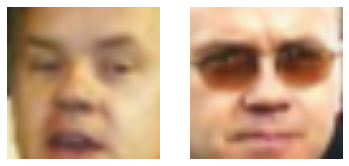

1824


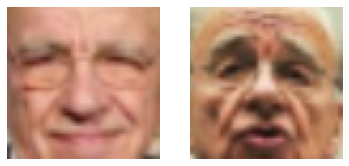

1828


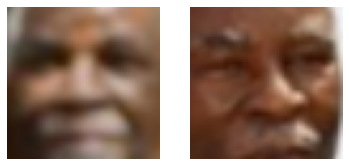

1830


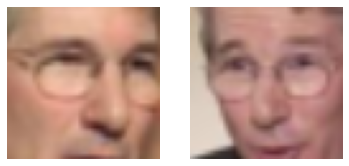

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1837


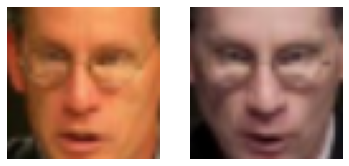

1840


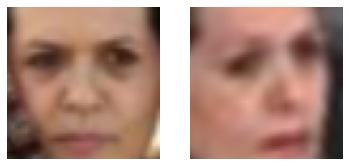

1841


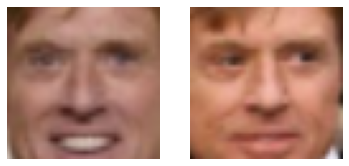

1843


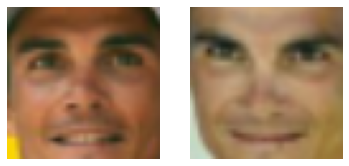

1844


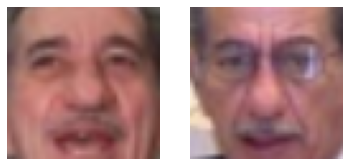

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1851


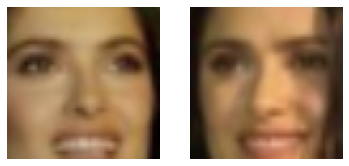

1861


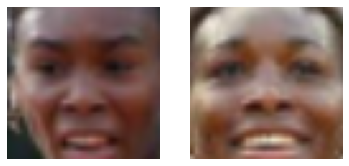

1866


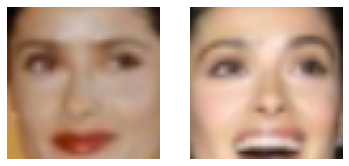

1868


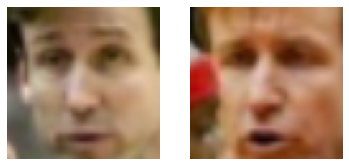

1889


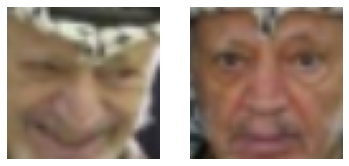

1891


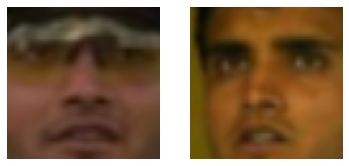

1894


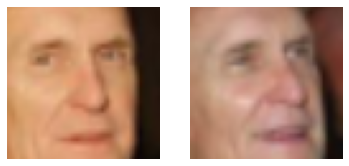

1910


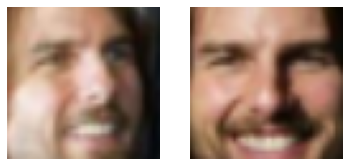

1912


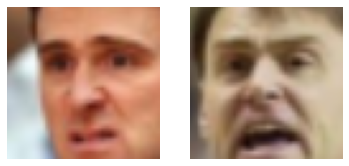

1918


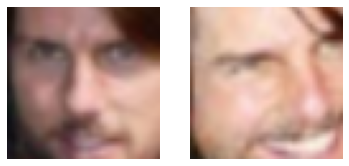

1923


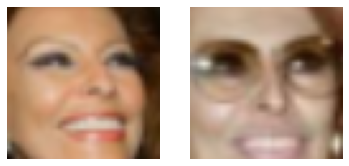

1936


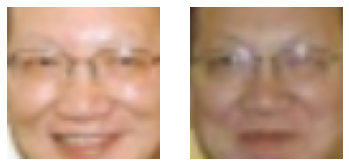

1947


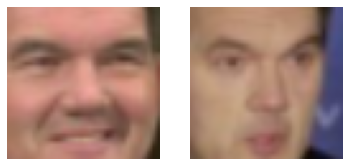

1948


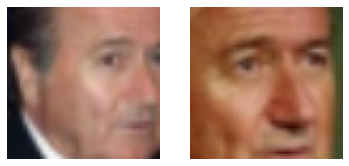

1952


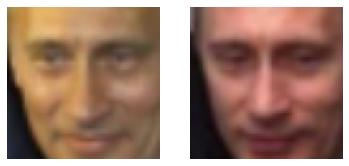

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1957


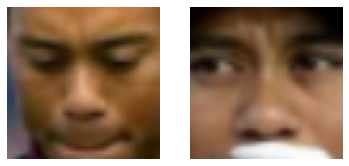

1961


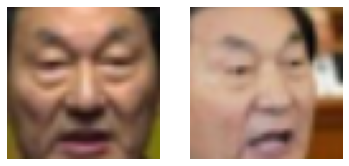

1965


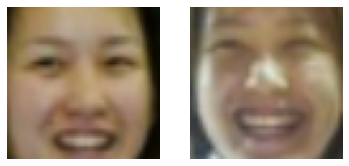

1968


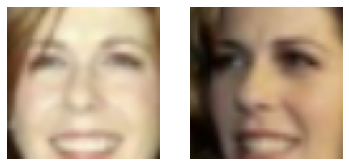

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1973


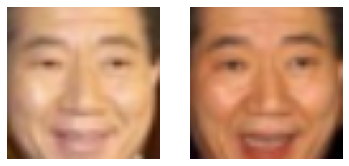

1982


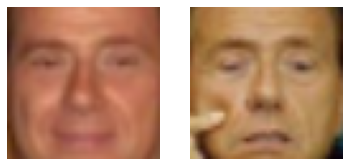

1983


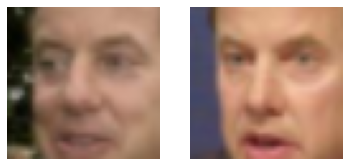

1985


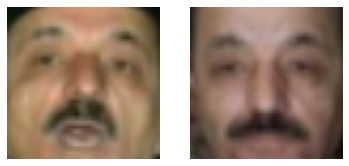

1993


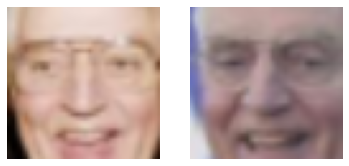

1996


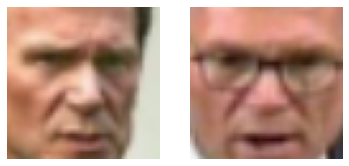

1997


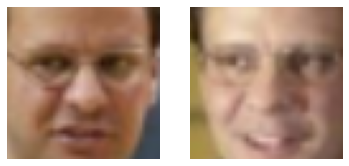

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2002


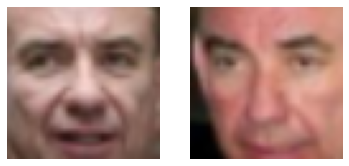

2003


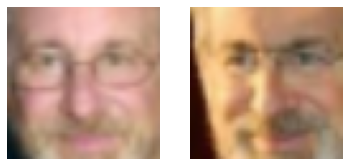

2006


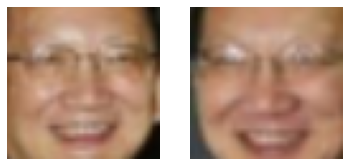

2014


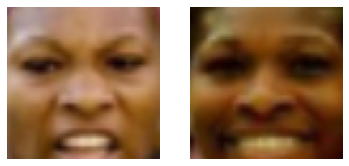

2025


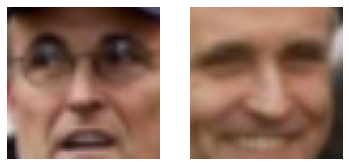

2031


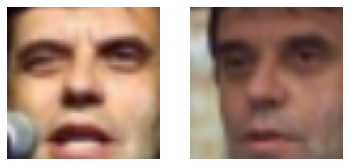

2034


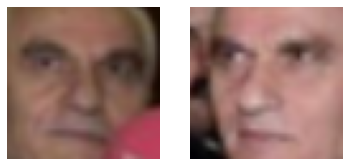

2038


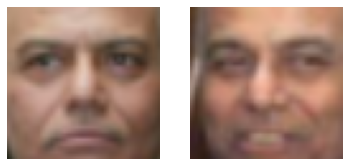

2042


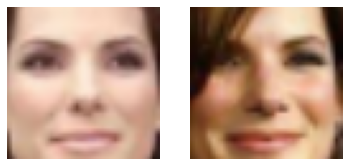

2046


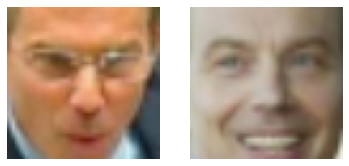

2082


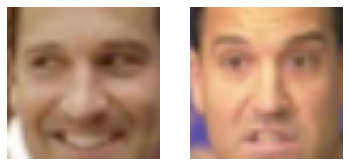

2084


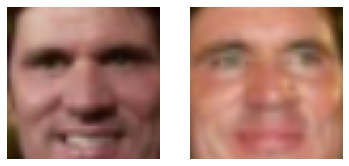

2097


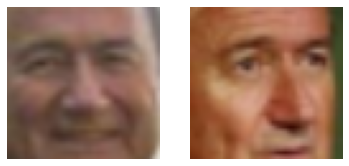

2103


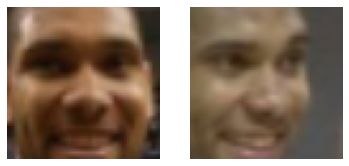

2106


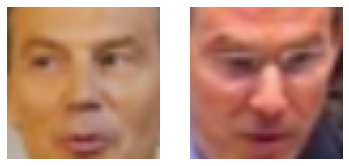

2111


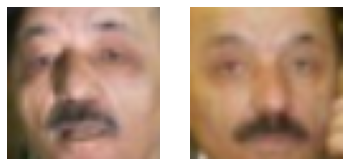

2117


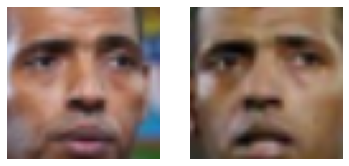

2126


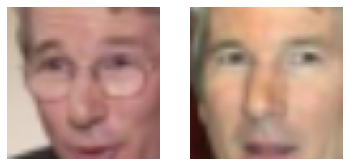

2127


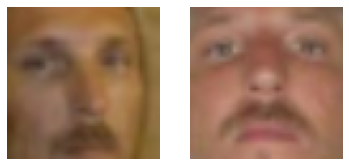

2128


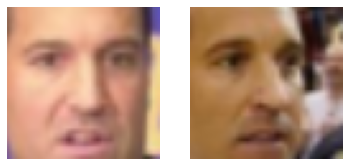

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2130


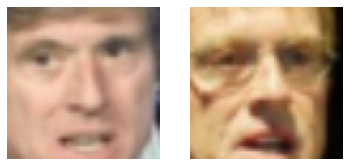

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2136


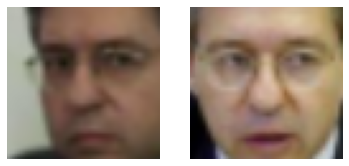

2140


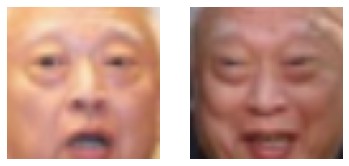

2148


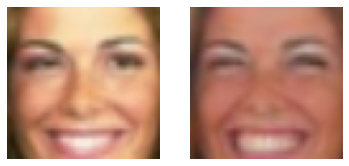

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2151


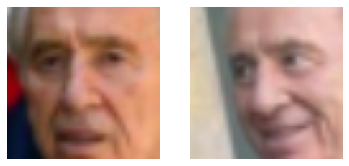

2156


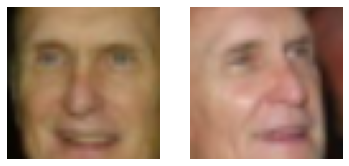

2161


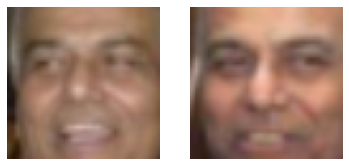

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2165


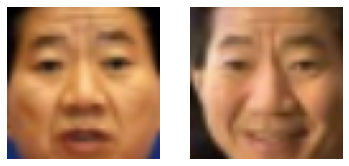

2166


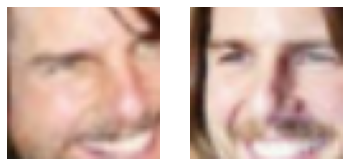

2169


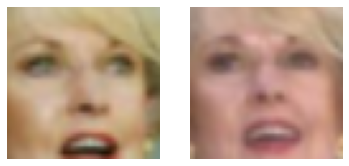

2177


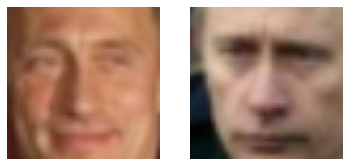

2181


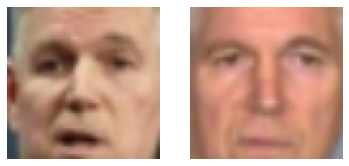

2184


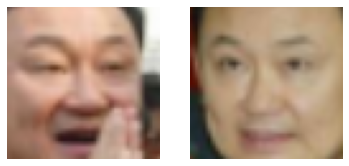

2188


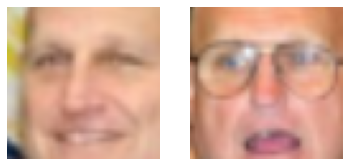

2195


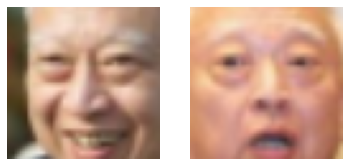

2199


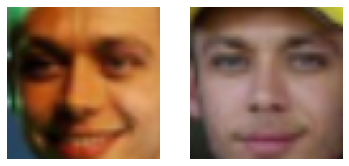

2206


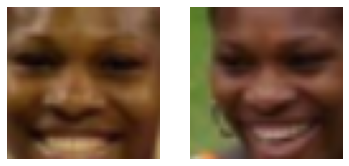

2211


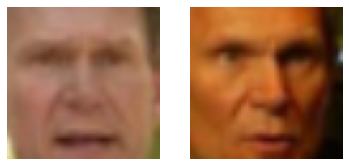

2213


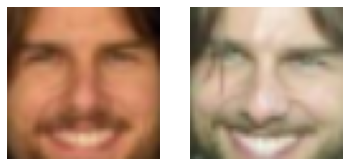

2214


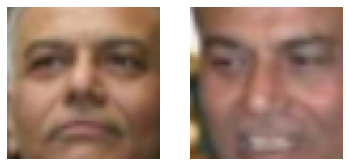

2215


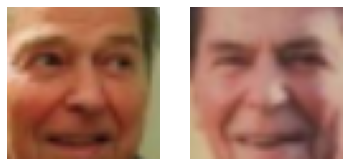

2219


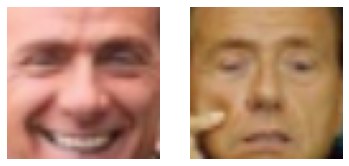

2221


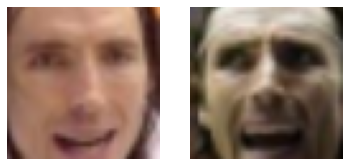

2232


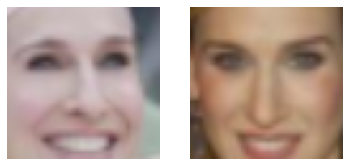

2240


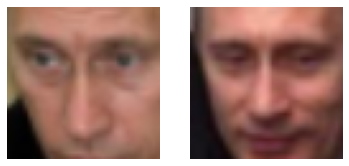

2243


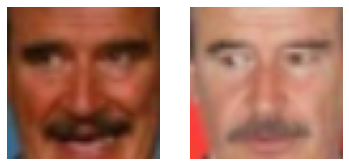

2247


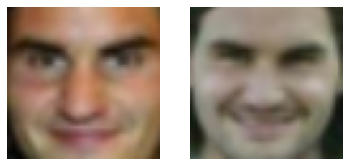

2266


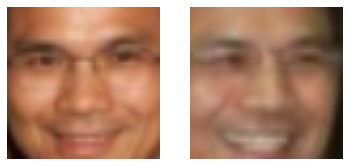

2286


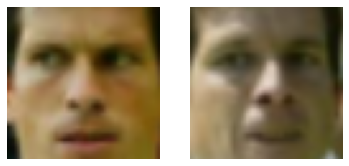

2289


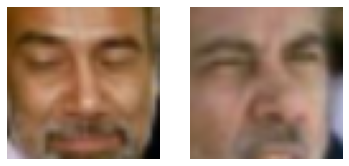

2298


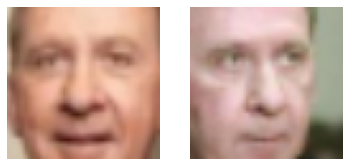

2300


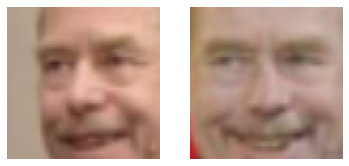

2309


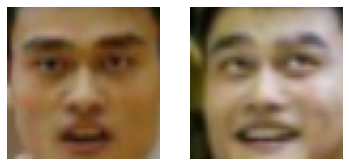

2310


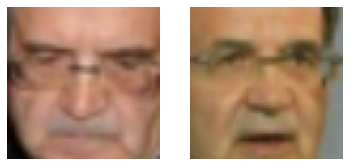

2311


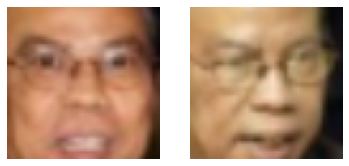

2314


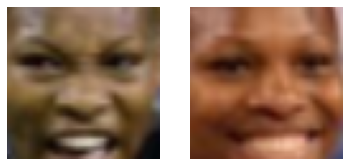

2315


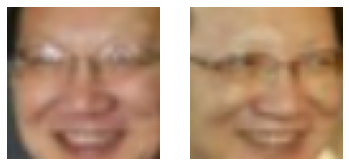

2324


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


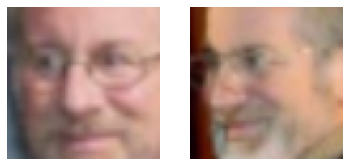

2328


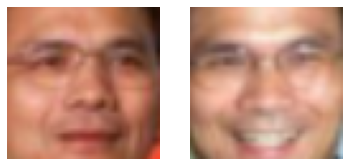

2333


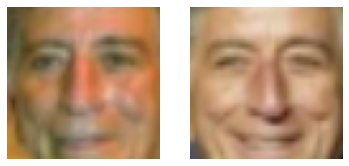

2368


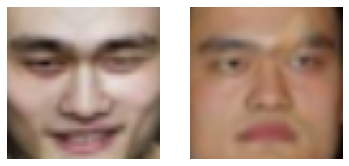

2387


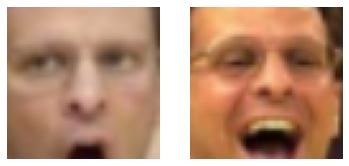

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2390


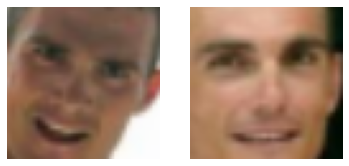

2394


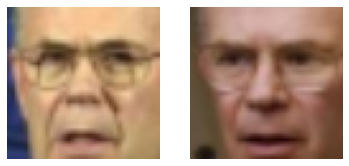

2397


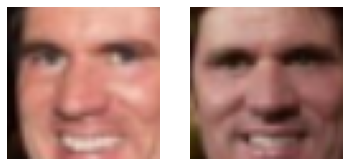

2408


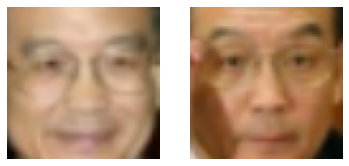

2418


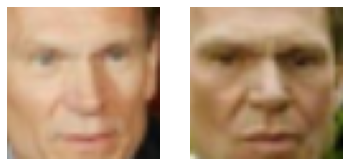

2420


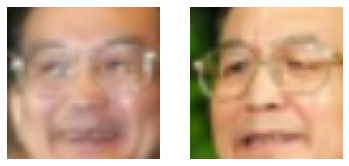

2425


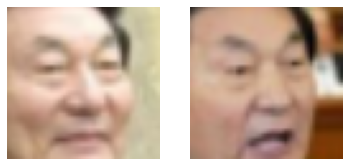

2431


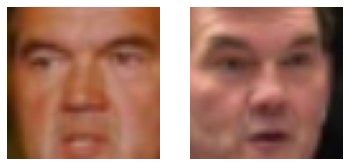

2435


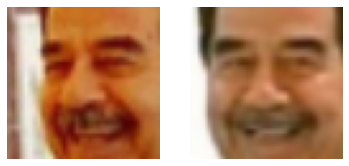

2444


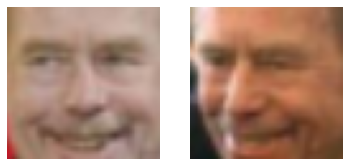

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2448


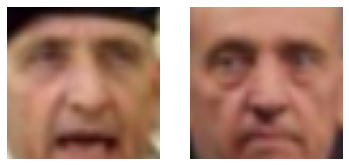

2454


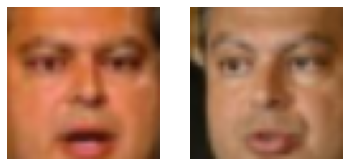

2459


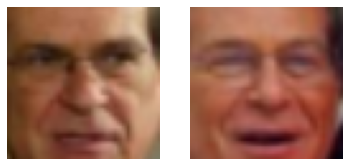

2467


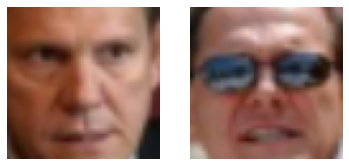

2468


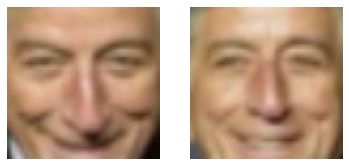

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2474


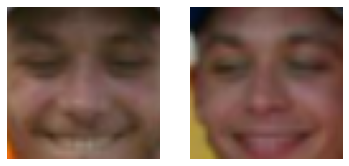

2478


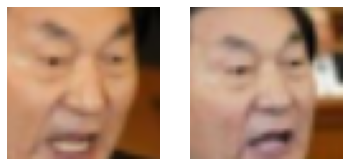

2483


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


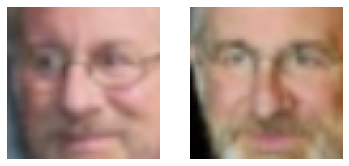

2485


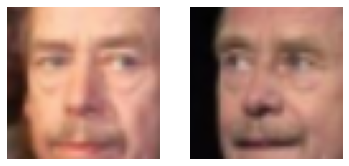

2489


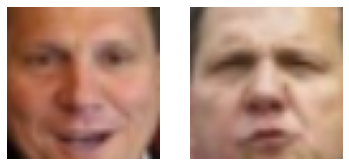

2495


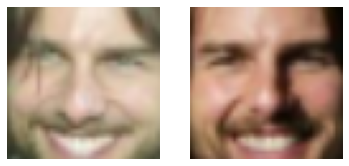

2497


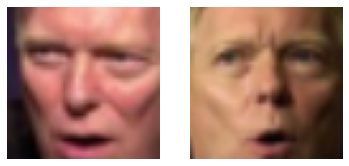

2498


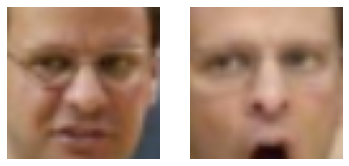

2499


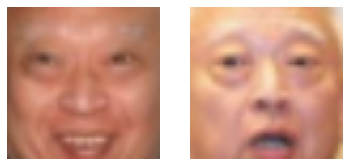

2500


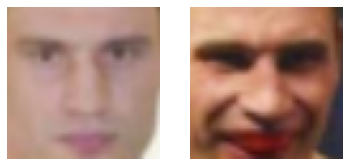

2502


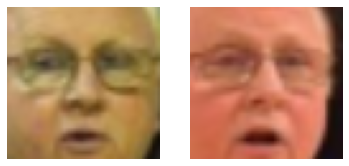

2506


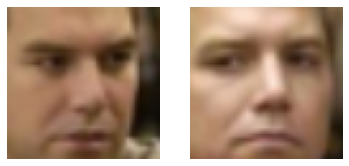

2508


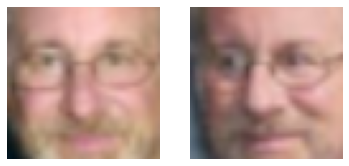

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2525


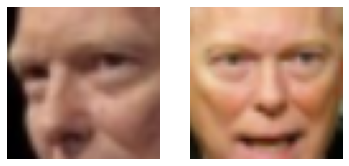

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2557


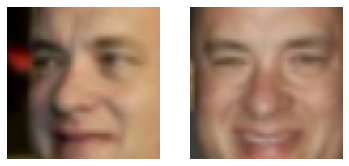

2559


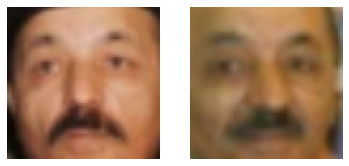

2565


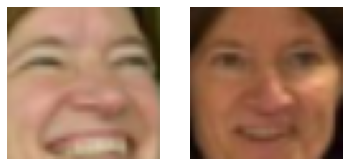

2566


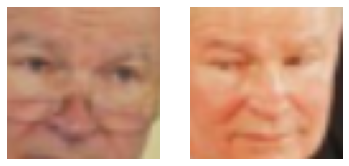

2571


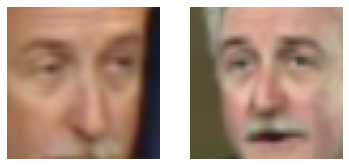

2577


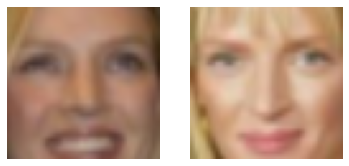

2584


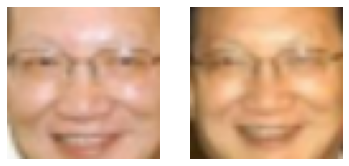

2595


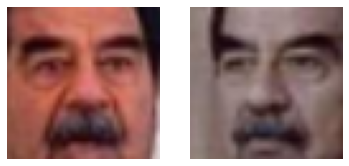

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2618


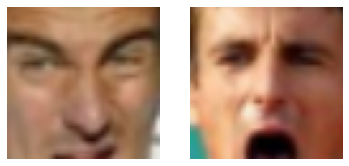

2620


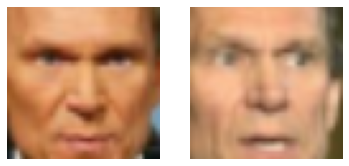

2638


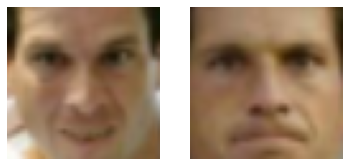

2643


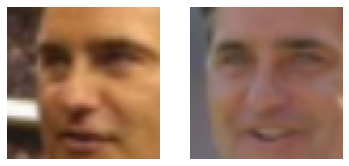

2651


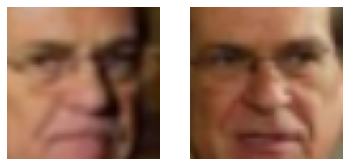

2654


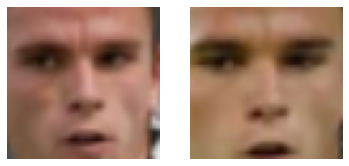

2655


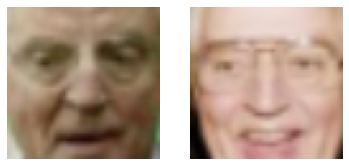

2656


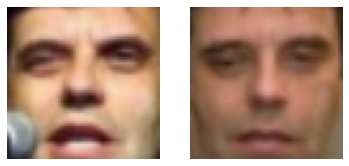

2676


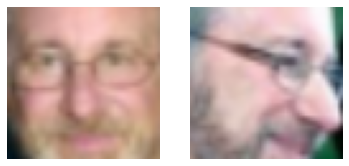

2678


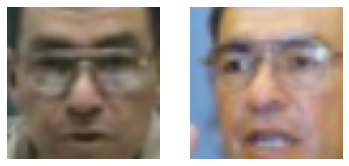

2685


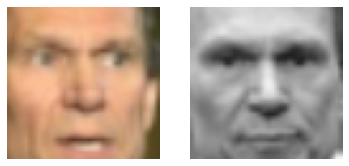

2697


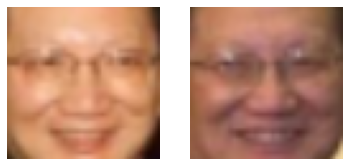

2700


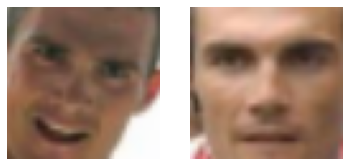

2705


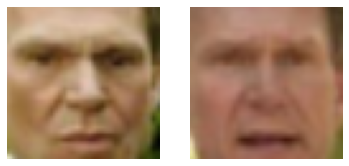

2707


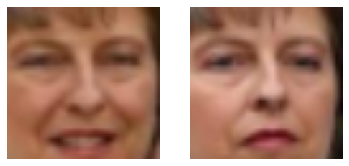

2717


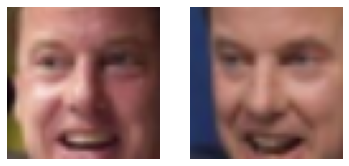

2718


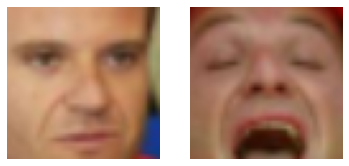

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2721


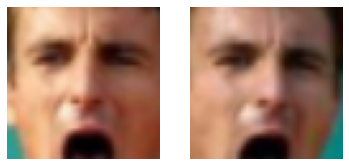

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2730


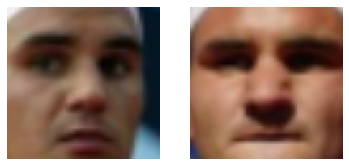

2731


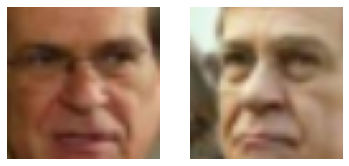

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2734


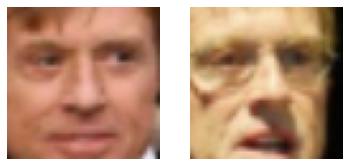

2735


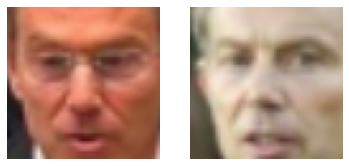

2741


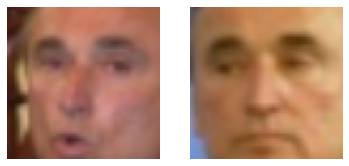

2767


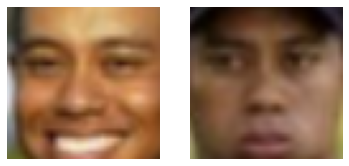

2768


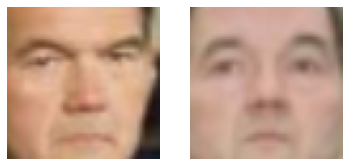

2773


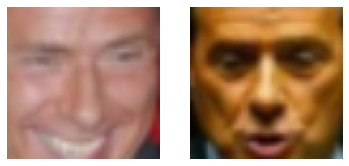

2783


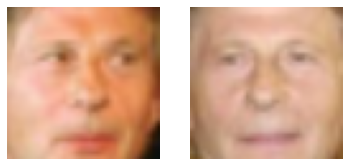

2790


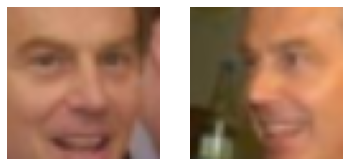

2796


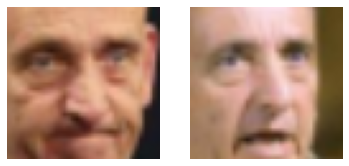

2797


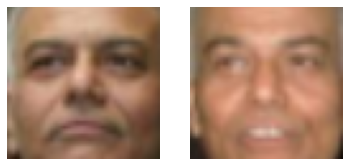

2810


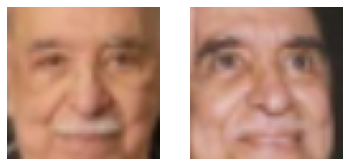

2814


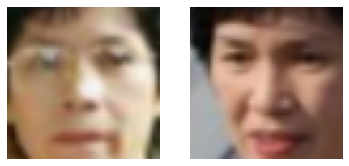

2825


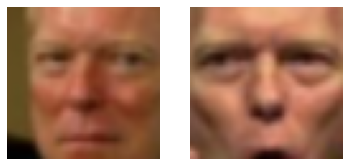

2830


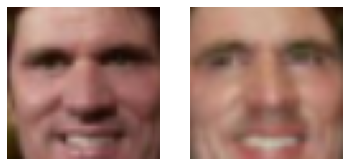

2845


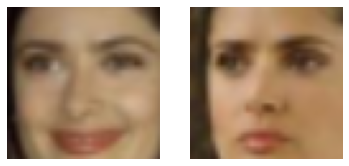

2846


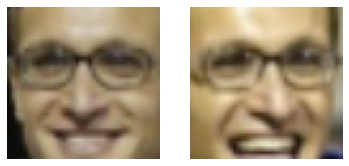

2848


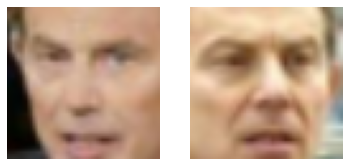

2853


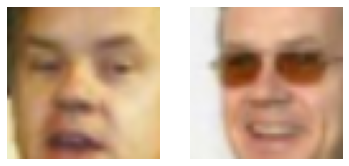

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2856


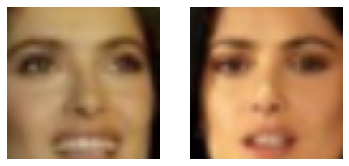

2860


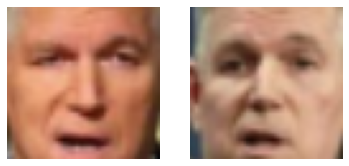

2863


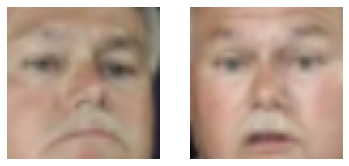

2880


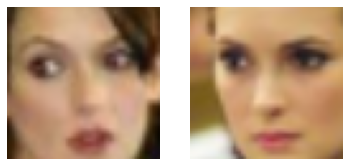

2884


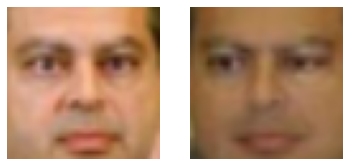

2886


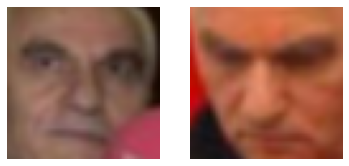

2890


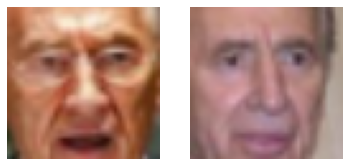

2893


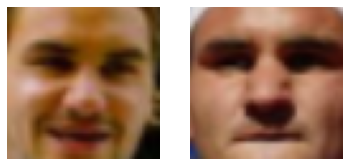

2902


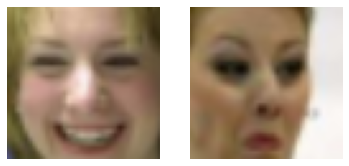

2905


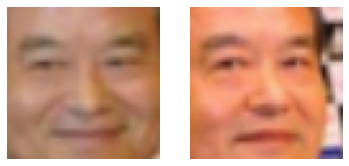

2906


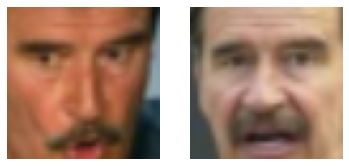

2908


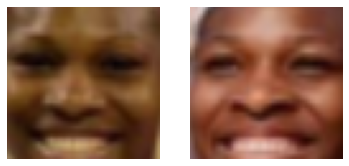

2909


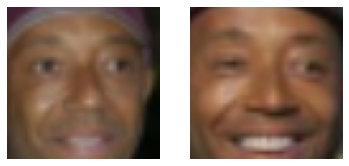

2910


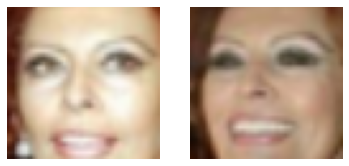

2912


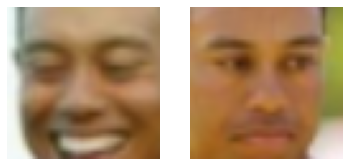

2919


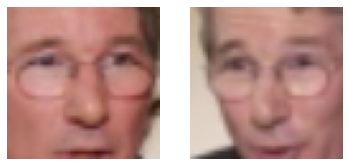

2925


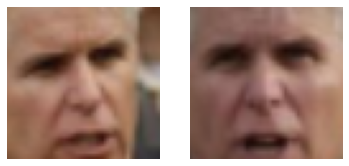

2928


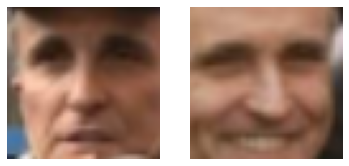

2936


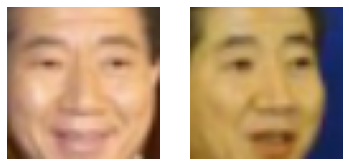

2941


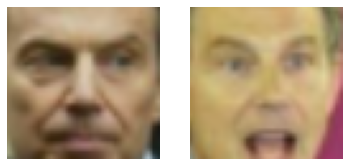

2946


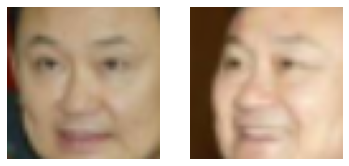

2952


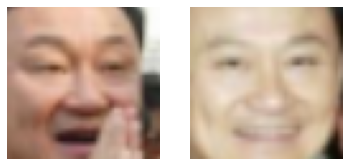

2956


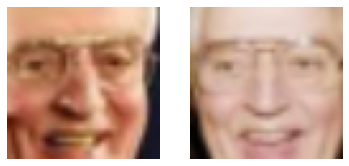

2961


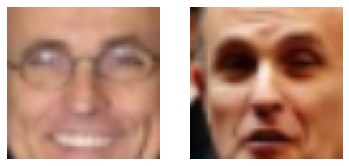

2963


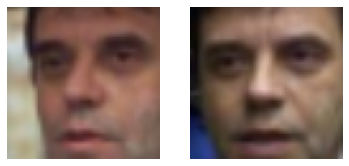

2974


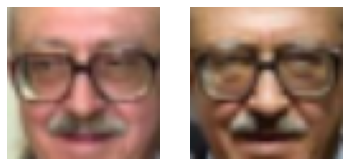

2981


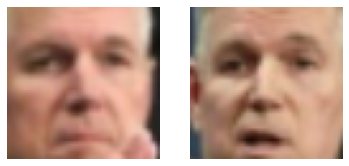

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2987


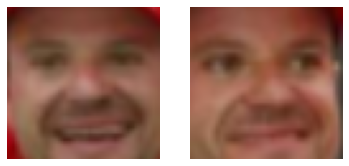

2992


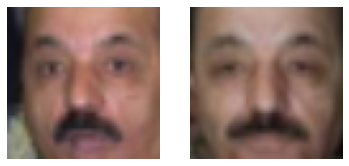

2994


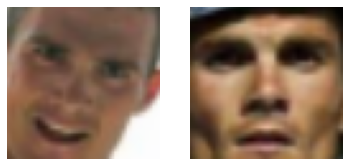

2998


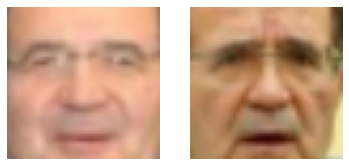

2999


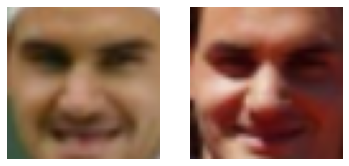

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3006


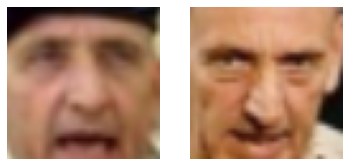

3018


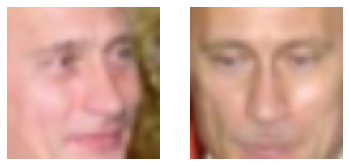

3024


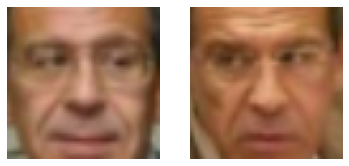

3035


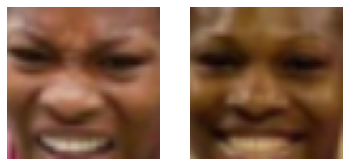

3037


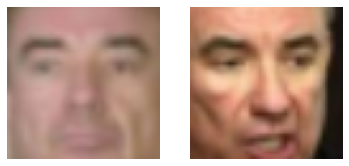

3042


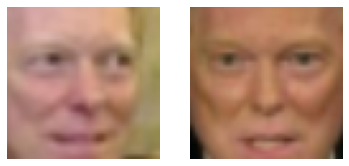

3063


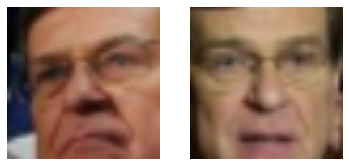

3065


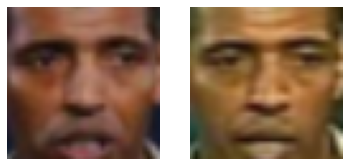

3079


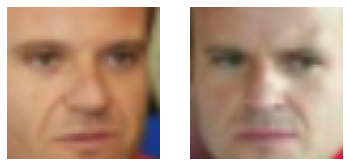

3083


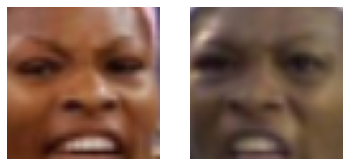

3086


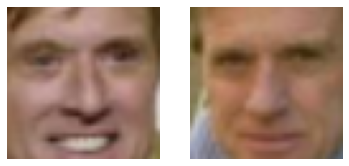

3087


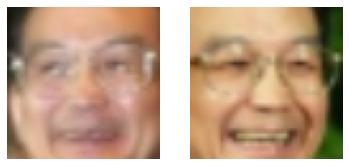

3091


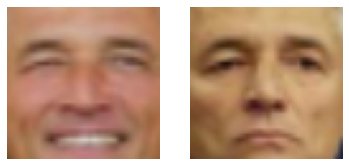

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3094


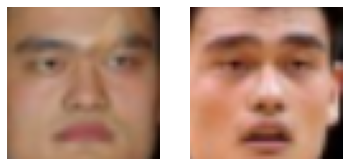

3097


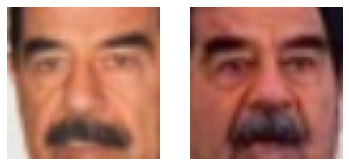

3099


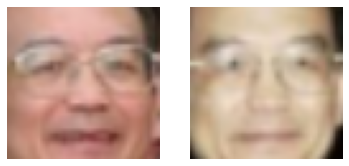

3100


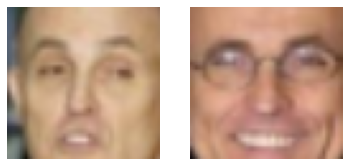

3108


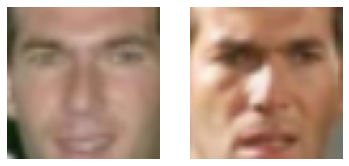

3113


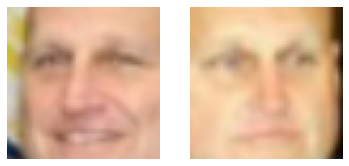

3116


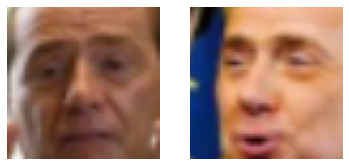

3127


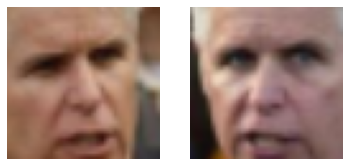

3137


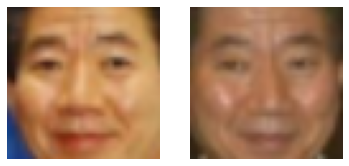

3142


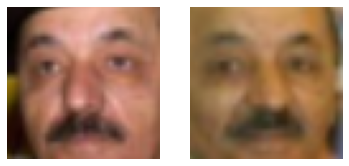

3149


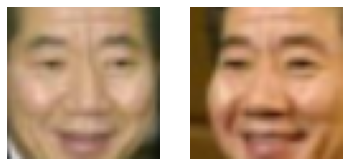

3151


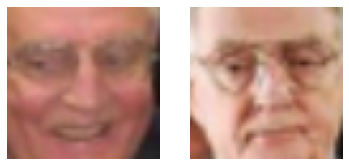

3152


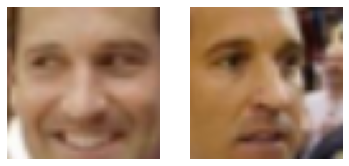

3153


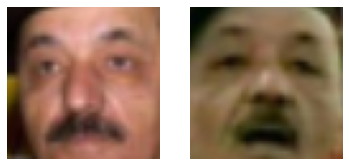

3156


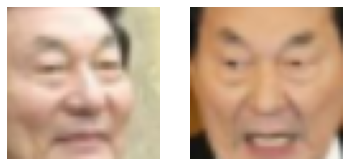

3167


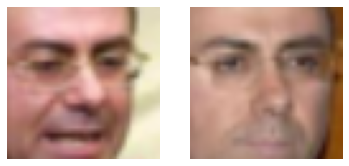

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3169


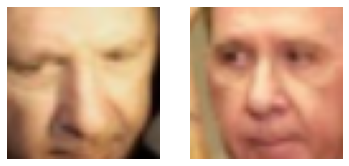

3179


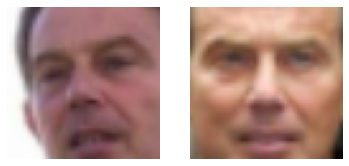

3188


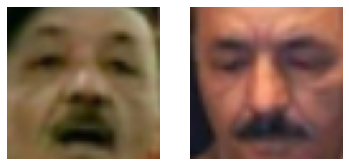

3190


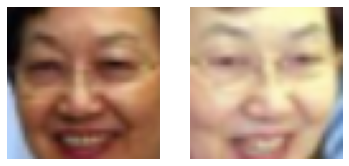

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3195


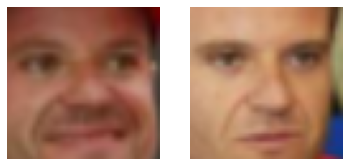

3198


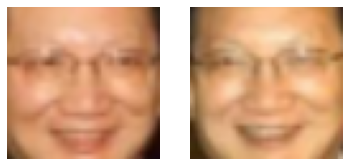

3211


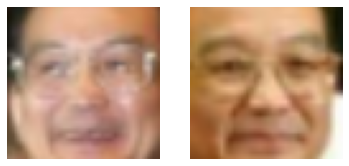

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3213


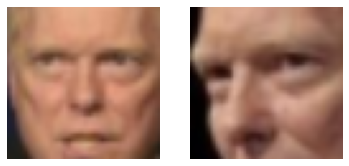

3218


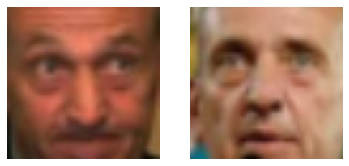

3222


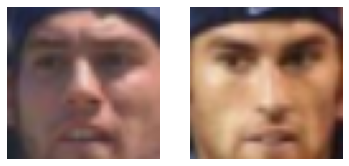

3225


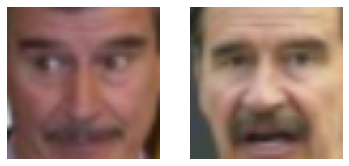

3230


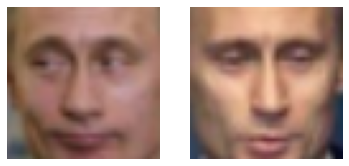

3238


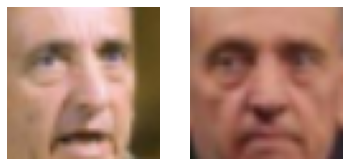

3245


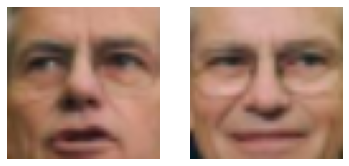

3254


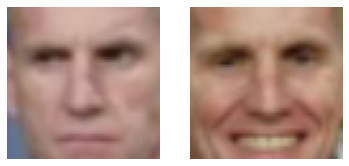

3273


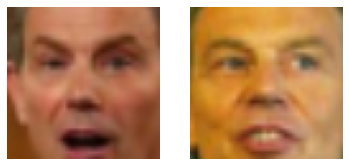

3278


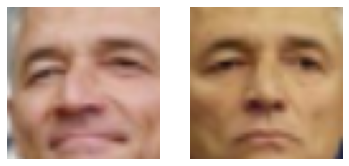

3284


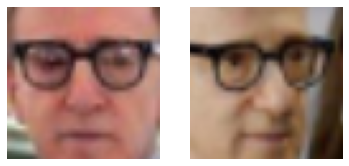

3291


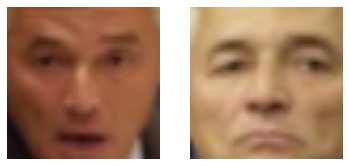

3295


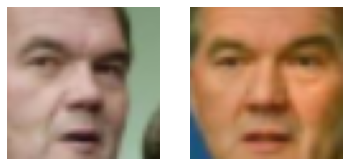

In [ ]:
### MISCLASSIFIED EXAMPLES

misclass_idx = np.where(np.array(y_pred) != np.array(y))[0]

print("FALSE NEGATIVES")

for step, (anchor_img, positive_img, negative_img) in enumerate(tqdm(pos_loader, desc="Processing", leave=False)):
    for img in range(len(anchor_img)) :
        if img+BATCH_TEST_SIZE*step in misclass_idx :
            print(img+BATCH_TEST_SIZE*step)
            plt.figure()
            plt.subplot(1,2,1)
            plt.imshow((resize100(anchor_img[img].numpy().transpose((1, 2, 0)))+mean)/255)
            plt.axis('off')
            plt.subplot(1,2,2)
            plt.imshow((resize100(positive_img[img].numpy().transpose((1, 2, 0)))+mean)/255)
            plt.axis('off')
            plt.show()

### Testing on my imgs

In [ ]:
from skimage.io import imread
from skimage.transform import resize

In [ ]:
def resize100(img):
    return resize(img, (100, 100), preserve_range=True, mode='reflect', anti_aliasing=True)[20:80,20:80,:]

In [ ]:
def print_my_img(path):
    plt.imshow(resize100(imread('./my_imgs/'+path))/255)
    plt.show()

In [ ]:
MY_IMGS_PATH = './my_imgs/'

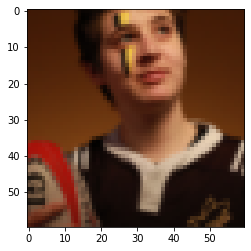

In [ ]:
print_my_img('profil_rugby.jpg')

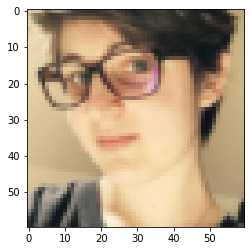

In [ ]:
print_my_img('profil_prepa.jpg')

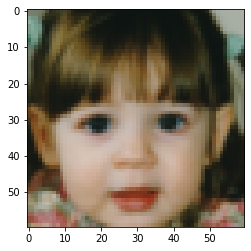

In [ ]:
print_my_img('img_enfant.jpg')

In [ ]:
dirs = sorted(os.listdir(MY_IMGS_PATH))
name_to_classid = {d:i for i,d in enumerate(dirs)}
classid_to_name = {v:k for k,v in name_to_classid.items()}
num_classes = len(name_to_classid)
print("number of classes: "+str(num_classes))

my_img_paths = {c:[directory + "/" + img for img in sorted(os.listdir(MY_IMGS_PATH+directory))] 
                for directory,c in name_to_classid.items()}

# retrieve all images
all_my_images_path = []
for img_list in my_img_paths.values():
    all_my_images_path += img_list

number of classes: 2


In [ ]:
all_my_images_path

['Mel/img_enfant.jpg', 'Mel/profil_prepa.jpg', 'Mel/profil_rugby.jpg']

In [ ]:
my_img_paths

{0: [],
 1: ['Mel/img_enfant.jpg', 'Mel/profil_prepa.jpg', 'Mel/profil_rugby.jpg']}

In [ ]:
all_my_imgs = []
for path in all_my_images_path:
    all_my_imgs += [np.expand_dims(resize100(imread(MY_IMGS_PATH+path)),0)]
return np.vstack(all_imgs)

In [ ]:
def authentification(df, id_img1, id_img2, neg_imgs_idx, threshold):

    id_img3 = neg_imgs_idx[random.randint(0,len(neg_imgs_idx))]

    img1 = df.Img.iloc[id_img1]
    img2 = df.Img.iloc[id_img2]
    img3 = df.Img.iloc[id_img3]

    image_transforms = transforms.Compose(
              [
                  transforms.ToTensor(),
              ]
          )

    anchor_img = torch.reshape(image_transforms(img1).to(device).float(), (1,3,60,60))
    positive_img = torch.reshape(image_transforms(img2).to(device).float(), (1,3,60,60))
    negative_img = torch.reshape(image_transforms(img3).to(device).float(), (1,3,60,60))

    anchor_out = model(anchor_img)
    positive_out = model(positive_img)
    negative_out = model(negative_img)

    loss = criterion(anchor_out, positive_out, negative_out)
    print("Loss: ", loss.cpu().detach().numpy())

    if loss < threshold :
        return 1
    
    return 0